In [1]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
import random
from torch.utils.data import DataLoader, TensorDataset
from matplotlib import animation
from IPython.display import HTML, display
from scipy.interpolate import CubicSpline, make_interp_spline, BarycentricInterpolator
from google.colab import drive

In [2]:

drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 1D Burgers' Equation

1D viscous Burgers' equation:

$$
\frac{\partial u}{\partial t} + u \frac{\partial u}{\partial x} = \nu \frac{\partial^2 u}{\partial x^2}
$$

Steps:
1. Discretize the PDE using an upwind finite difference method.
2. Train a neural network to predict $ u_i^{n+1} $ using:
   - 5 values from time step $n$ (`u^{n}`)
   - 4 neighboring values from time step $n+1$ (`u^{n+1}`)
3. Roll out the model forward in time using fixed-point iteration.
4. Compare the learned solution to the reference solver.

In [4]:
def set_seed(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)  # If using CUDA
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seed(42)

In [5]:
# Parameters
N = 100
x = np.linspace(0, 1, N)
dx = x[1] - x[0]
dx_fine = dx.copy()
dt = 0.001
nu = 0.01
t_end = 0.1

In [6]:
def get_initial_condition(case='sine', x=x):
    if x is None:
        raise ValueError("Must provide X")
    if case == 'sine':
        return np.sin(2 * np.pi * x)
    elif case == 'cosine':
        return np.cos(4 * np.pi * x)
    elif case == 'mixed':
        return np.sin(2*np.pi*x) + 0.5*np.sin(4*np.pi*x)
    elif case == 'square_wave':
        return np.sign(np.sin(2*np.pi*x))
    elif case == 'step':
        return np.where(x < 0.5, 1.0, 0.0)
    elif case == 'double_step':
        return np.where((x > 0.3) & (x < 0.7), 1.0, 0.0)
    elif case == 'gaussian':
        return np.exp(-100 * (x - 0.5)**2)
    elif case == 'double_gaussian':
        return np.exp(-100 * (x - 0.3)**2) + np.exp(-100 * (x - 0.7)**2)
    elif case == 'tent':
        return np.maximum(1 - 2*np.abs(x - 0.5), 0)
    elif case == 'random':
        np.random.seed(42)
        return np.random.rand(N)
    elif case == 'noise_bump':
        np.random.seed(42)
        return np.exp(-100*(x - 0.5)**2) + 0.1*np.random.randn(N)

    # New cases below:
    elif case == 'sawtooth':
        return 2 * (x - np.floor(x + 0.5))  # Sawtooth wave between -1 and 1
    elif case == 'triangle':
        return 2 * np.abs(2 * (x - np.floor(x + 0.5))) - 1  # Triangle wave
    elif case == 'parabolic':
        return 1 - 4*(x - 0.5)**2  # Inverted parabola centered at 0.5
    elif case == 'exp_rise':
        return np.exp(5 * (x - 1))  # Exponential increase toward x = 1
    elif case == 'exp_fall':
        return np.exp(-5 * x)       # Exponential decay from x = 0
    elif case == 'tanh_wall':
        return 0.5 * (np.tanh((x - 0.5)/0.05) + 1)  # Smooth step from 0 to 1
    elif case == 'pulse_train':
        return np.sin(10 * np.pi * x)**4  # Narrow sharp peaks
    elif case == 'discontinuity':
        return np.where(x < 0.25, 1.0, np.where(x < 0.75, 0.5, 0.0))  # 3-step profile
    elif case == "square_wave2":
        return np.where((x > 0.3) & (x < 0.7), 1.0, 0.0)

    else:
        raise ValueError("Unknown initial condition type.")

Train the operator with the inital condition below:

Solve the Burger's equation with the upwind difference method:

In [7]:
def upwind_step(u, dx, dt, nu):
    N = len(u)
    un = u.copy()
    dudx = np.zeros_like(u)

    # First-order upwind for advection term
    for i in range(1, N - 1):
        if un[i] > 0:
            dudx[i] = (un[i] - un[i - 1]) / dx
        else:
            dudx[i] = (un[i + 1] - un[i]) / dx

    # Second-order central difference for diffusion
    d2udx2 = np.zeros_like(u)
    d2udx2[1:-1] = (un[:-2] - 2 * un[1:-1] + un[2:]) / dx**2

    # Time update
    u_new = un - dt * un * dudx + nu * dt * d2udx2
    u_new[0] = u_new[-1] = 0  # Dirichlet boundary

    return u_new

Generate data:

In [8]:
t = 0
stencils = []
targets = []

init_types = [
    'sine',
    'cosine',
    'mixed',
    'square_wave',
    'step',
    'double_step',
    'gaussian',
    'double_gaussian',
    'tent'
    #'random',
    #'noise_bump'
]
for init_type in init_types:
    u = get_initial_condition(init_type)
    t = 0
    while t < t_end:
        u_next = upwind_step(u.copy(), dx, dt, nu)
        for i in range(2, N - 2):
            stencil = [
                u[i-2], u[i-1], u[i], u[i+1], u[i+2],
                u_next[i-2], u_next[i-1], u_next[i+1], u_next[i+2]
            ]
            stencils.append(stencil)
            targets.append(u_next[i])
        u = u_next.copy()
        t += dt


stencils = np.array(stencils, dtype=np.float32)
targets = np.array(targets, dtype=np.float32)

# Shuffle
# perm = np.random.permutation(len(stencils))
# stencils = stencils[perm]
# targets = targets[perm]

# Normalize
X = torch.tensor(stencils)
y = torch.tensor(targets).unsqueeze(1)

mean = X.mean(0, keepdim=True)
std = X.std(0, keepdim=True)
X_norm = (X - mean) / std


X = X.to(device)
y = y.to(device)
X_norm = X_norm.to(device)
mean = mean.to(device)
std = std.to(device)

In [9]:
print(X.shape, y.shape)

torch.Size([86400, 9]) torch.Size([86400, 1])


In [10]:
# Assuming X_norm and y are already created as torch tensors and moved to device
# If not, ensure you do that before creating the TensorDataset

# Create a TensorDataset from your normalized features and targets
dataset = TensorDataset(X_norm, y)

# Define batch size (you can adjust this)
batch_size = 64

# Create the DataLoader
# shuffle=True is generally recommended for training data
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

Create a simple FNN model:

In [11]:
class InterpolationOperator(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(9, 128),
            nn.ReLU(),

            nn.Linear(128, 128),
            nn.ReLU(),

            nn.Linear(128, 128),
            nn.ReLU(),

            nn.Linear(128, 128),
            nn.ReLU(),

            nn.Linear(128, 128),
            nn.ReLU(),

            nn.Linear(128, 128),
            nn.ReLU(),

            nn.Linear(128, 128),
            nn.ReLU(),


            nn.Linear(128, 1)
        )

    def forward(self, x):
        return self.net(x)

##Training loop

In [13]:
base_model = InterpolationOperator().to(device)
optimizer = optim.Adam(base_model.parameters(), lr=1e-5)
scheduler = StepLR(optimizer, step_size=30, gamma=0.1)
loss_fn = nn.MSELoss()

# Example training loop using the dataloader
for epoch in range(150):
    for batch_X, batch_y in dataloader:
        # Move batch data to the same device as your model
        batch_X = batch_X.to(device)
        batch_y = batch_y.to(device)

        # Forward pass
        pred = base_model(batch_X)
        loss = loss_fn(pred, batch_y)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Optionally step the scheduler after each epoch
    scheduler.step()

    if epoch % 1 == 0:
        print(f"Epoch {epoch}, Loss: {loss.item():.8f}") # Note: This prints the loss of the *last* batch

Epoch 0, Loss: 0.00029837
Epoch 1, Loss: 0.00007193
Epoch 2, Loss: 0.00006920
Epoch 3, Loss: 0.00011949
Epoch 4, Loss: 0.00000449
Epoch 5, Loss: 0.00002875
Epoch 6, Loss: 0.00002716
Epoch 7, Loss: 0.00000346
Epoch 8, Loss: 0.00000129
Epoch 9, Loss: 0.00000139
Epoch 10, Loss: 0.00000340
Epoch 11, Loss: 0.00000110
Epoch 12, Loss: 0.00000056
Epoch 13, Loss: 0.00000369
Epoch 14, Loss: 0.00000065
Epoch 15, Loss: 0.00000064
Epoch 16, Loss: 0.00000021
Epoch 17, Loss: 0.00000157
Epoch 18, Loss: 0.00000027
Epoch 19, Loss: 0.00000040
Epoch 20, Loss: 0.00000024
Epoch 21, Loss: 0.00000064
Epoch 22, Loss: 0.00000058
Epoch 23, Loss: 0.00000019
Epoch 24, Loss: 0.00000022
Epoch 25, Loss: 0.00000026
Epoch 26, Loss: 0.00000155


KeyboardInterrupt: 

In [ ]:
torch.save({
    'model_state_dict': base_model.state_dict(),
    'mean': mean,
    'std': std
}, '/content/drive/MyDrive/interp_operator_pg.pt')


NameError: name 'base_model' is not defined

In [12]:
# Rebuild the model class
model = InterpolationOperator()

# Load checkpoint
print(device)
checkpoint = torch.load('/content/drive/MyDrive/interp_operator_pg.pt',map_location=torch.device('cpu'))
model.load_state_dict(checkpoint['model_state_dict'])

# Set to eval mode if needed
model.eval()

# Restore normalization
mean = checkpoint['mean']
std = checkpoint['std']




cpu


In [13]:
model.to(device)
mean.to(device)
std.to(device)

tensor([[0.6125, 0.6132, 0.6138, 0.6140, 0.6139, 0.6117, 0.6124, 0.6132, 0.6131]])

# Using the operator

Apply the operator:

Some utilities function:

In [14]:
def generate_random_initial(seed=None, plot=True):
    if seed is not None:
        np.random.seed(seed)
    u0 = np.random.rand(N)  # Uniform between 0 and 1
    u0[0:2] = u0[-2:] = 0  # Dirichlet boundary conditions

    return u0


def pg_dissipation(u_next, u_current, i, dx, alpha=0.1):
    # 1. Compute residual
    Ri = u_next[i] - u_current[i]

    # 2. Gradient of u
    grad_u = (u_next[i+1] - u_next[i-1]) / (2 * dx)

    # 3. Effective diffusion coefficient
    k_eff = alpha * abs(Ri) / (1e-5 + abs(grad_u))

    # 4. Compute k_eff at neighbors using same residual formulation
    # (this is an approximation assuming a smooth k_eff field)
    Ri_p = u_next[i+1] - u_current[i+1]
    Ri_m = u_next[i-1] - u_current[i-1]
    grad_p = (u_next[i+2] - u_next[i]) / (2 * dx)
    grad_m = (u_next[i] - u_next[i-2]) / (2 * dx)
    k_p = alpha * abs(Ri_p) / (1e-5 + abs(grad_p))
    k_m = alpha * abs(Ri_m) / (1e-5 + abs(grad_m))

    # 5. Discrete Laplacians
    lap_u = (u_next[i+1] - 2*u_next[i] + u_next[i-1]) / dx**2
    lap_ku = (k_p*u_next[i+1] - 2*k_eff*u_next[i] + k_m*u_next[i-1]) / dx**2
    lap_k = (k_p - 2*k_eff + k_m) / dx**2

    # 6. Full Petrov-Galerkin dissipation
    dissipation = 0.5 * (k_eff * lap_u + lap_ku - u_next[i] * lap_k)

    return dissipation


# def pg_dissipation(pred_high, u_current, i, dx, dt, nu, alpha=0.1):
#     """
#     Petrov-Galerkin dissipation term based on residual between high-order (NN) and low-order (upwind) prediction.
#     """
#     # 1. Low-order numerical prediction using first-order upwind + diffusion
#     dudx = (u_current[i] - u_current[i-1]) / dx
#     d2udx2 = (u_current[i+1] - 2 * u_current[i] + u_current[i-1]) / dx**2
#     pred_low = u_current[i] - dt * (u_current[i] * dudx) + nu * dt * d2udx2

#     # 2. Residual
#     Ri = pred_high - pred_low

#     # 3. Central gradient
#     grad_u = (u_current[i+1] - u_current[i-1]) / (2 * dx)

#     # 4. Effective diffusion coefficient
#     k_eff = alpha * abs(Ri) / (1e-5 + abs(grad_u))

#     # 5. Approximate neighbors (smooth k field assumption)
#     def local_k(j):
#         dudx_j = (u_current[j] - u_current[j - 1]) / dx
#         d2udx2_j = (u_current[j+1] - 2 * u_current[j] + u_current[j-1]) / dx**2
#         pred_low_j = u_current[j] - dt * (u_current[j] * dudx_j) + nu * dt * d2udx2_j
#         Ri_j = pred_high - pred_low_j  # approximate reuse of pred_high for neighbors
#         grad_j = (u_current[j+1] - u_current[j-1]) / (2 * dx)
#         return alpha * abs(Ri_j) / (1e-5 + abs(grad_j))

#     k_p = local_k(i + 1)
#     k_m = local_k(i - 1)

#     # 6. Discrete Laplacians
#     lap_u = (u_current[i+1] - 2*u_current[i] + u_current[i-1]) / dx**2
#     lap_ku = (k_p * u_current[i+1] - 2 * k_eff * u_current[i] + k_m * u_current[i-1]) / dx**2
#     lap_k = (k_p - 2 * k_eff + k_m) / dx**2

#     # 7. Final PG dissipation
#     dissipation = 0.5 * (k_eff * lap_u + lap_ku - u_current[i] * lap_k)

#     return dissipation


# def pg_dissipation(pred_high, u_current, i, dx, dt, nu, alpha=0.1, eps_k=1e-5):
#     """
#     Computes Petrov-Galerkin dissipation based on residual between:
#     - High-order prediction: NN (pred_high)
#     - Low-order prediction: upwind + diffusion

#     Returns PG stabilising term to be added to the NN prediction.
#     """
#     # --- 1. Low-order finite difference prediction at point i ---
#     dudx_i = (u_current[i] - u_current[i - 1]) / dx
#     d2udx2_i = (u_current[i + 1] - 2 * u_current[i] + u_current[i - 1]) / dx**2
#     pred_low_i = u_current[i] - dt * u_current[i] * dudx_i + dt * nu * d2udx2_i

#     # --- 2. Residual: High-order - Low-order ---
#     Ri = pred_high - pred_low_i

#     # --- 3. Central gradient at point i ---
#     grad_u_i = (u_current[i + 1] - u_current[i - 1]) / (2 * dx)

#     # --- 4. Effective diffusion coefficient at i ---
#     k_eff = alpha * abs(Ri) / (eps_k + abs(grad_u_i))

#     # --- 5. Estimate k at neighbors i-1 and i+1 (with their own low-order predictions) ---
#     def k_at(j):
#         dudx_j = (u_current[j] - u_current[j - 1]) / dx
#         d2udx2_j = (u_current[j + 1] - 2 * u_current[j] + u_current[j - 1]) / dx**2
#         pred_low_j = u_current[j] - dt * u_current[j] * dudx_j + dt * nu * d2udx2_j
#         Ri_j = u_current[j] - pred_low_j  # We use u_current[j] to mimic 'pred_high' at neighbor
#         grad_j = (u_current[j + 1] - u_current[j - 1]) / (2 * dx)
#         return alpha * abs(Ri_j) / (eps_k + abs(grad_j))

#     k_p = k_at(i + 1)
#     k_m = k_at(i - 1)

#     # --- 6. Discrete Laplacians ---
#     lap_u  = (u_current[i + 1] - 2 * u_current[i] + u_current[i - 1]) / dx**2
#     lap_ku = (k_p * u_current[i + 1] - 2 * k_eff * u_current[i] + k_m * u_current[i - 1]) / dx**2
#     lap_k  = (k_p - 2 * k_eff + k_m) / dx**2

#     # --- 7. Final Petrov-Galerkin dissipation term ---
#     dissipation = 0.5 * (k_eff * lap_u + lap_ku - u_current[i] * lap_k)

#     return dissipation






def get_noisy_initial_condition(case='gaussian', noise_level=0.05):
    base = get_initial_condition(case)
    noise = noise_level * np.random.randn(N)
    noisy = base + noise
    noisy[0:2] = noisy[-2:] = 0  # Enforce Dirichlet BC
    return noisy


def rollout_reference_solution(u_ref, dx, dt, nu, t_end):
    t = 0
    while t < t_end:
        u_ref = upwind_step(u_ref.copy(), dx, dt, nu)
        t += dt
    return u_ref



def generate_initial_conditions(initial_type, random=False, noise=False, seed=42):
    """
    Generate consistent initial, reference, and working copies of initial condition.
    """
    if noise:
        noise_level = 0.05
        u = get_noisy_initial_condition(initial_type, noise_level)
    elif random:
        np.random.seed(seed)
        u = generate_random_initial()
    else:
        u = get_initial_condition(initial_type)

    return u.copy(), u.copy(), u.copy()


def run_fixed_point_step(u_current, base_model, mean, std, dx, dt, pg=False, alpha=0.01):
    """
    Perform one full time step using fixed-point iterations with or without PG.
    """
    u_next = u_current.copy()
    for _ in range(5):  # fixed-point iteration
        u_new = u_next.copy()
        for i in range(2, len(u_current) - 2):
            stencil = [
                u_current[i-2], u_current[i-1], u_current[i], u_current[i+1], u_current[i+2],
                u_next[i-2], u_next[i-1], u_next[i+1], u_next[i+2]
            ]
            stencil_tensor = torch.tensor([stencil], dtype=torch.float32, device=device)
            stencil_tensor = (stencil_tensor - mean.to(device)) / std.to(device)
            pred = base_model(stencil_tensor).item()

            if pg:
                diss = pg_dissipation(pred, u_current, i, dx, dt, nu, alpha=alpha)
                u_new[i] = pred + dt * diss
            else:
                u_new[i] = pred
        u_new[0:2] = u_new[-2:] = 0
        u_next = u_new.copy()
    return u_next



In [15]:
def inference(initial_type='sine', plot=True, random=False, noise=False, pg=False, alpha=0.01):
    # Initial condition setup
    u_current, u_ref, u_init = generate_initial_conditions(initial_type, random, noise)

    # Interpolation opeartor solution
    t = 0
    while t < t_end:
        u_current = run_fixed_point_step(u_current, model, mean, std, dx, dt, pg, alpha)
        t += dt



    # Reference solution
    u_ref = rollout_reference_solution(u_ref, dx, dt, nu, t_end)

    # Convert to NumPy
    u_current = np.array(u_current)
    u_init = np.array(u_init)
    u_ref = np.array(u_ref)

    # Plot
    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x, u_init, label="Initial")
        plt.plot(x, u_ref, label="Reference")
        label = "Neural + PG" if pg else "Neural"
        plt.plot(x, u_current, label=label, linestyle='--')
        plt.title(f"Inference: {initial_type}")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return u_current, u_ref

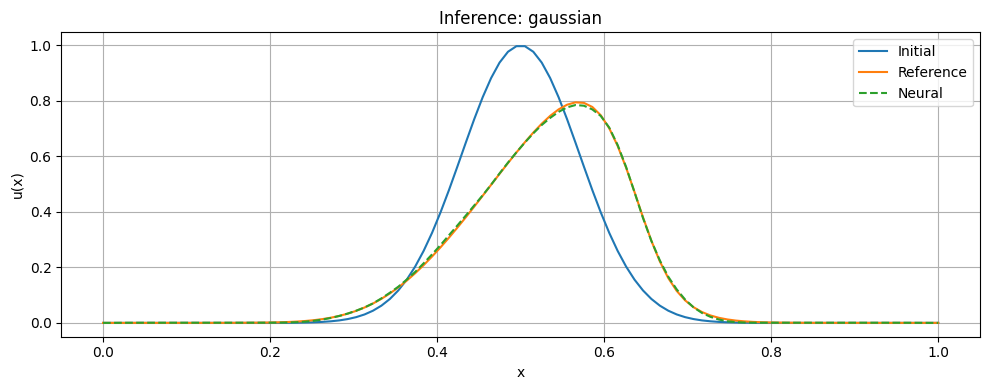

In [16]:
_,_ = inference('gaussian', pg=False)

In [ ]:
_,_ = inference('parabolic', pg=True)

In [ ]:
_,_ = inference('sine', noise=True)

In [ ]:
u_correct,_ = inference('sine', noise=False)

_, _, u_ref= generate_initial_conditions("sine")
u_ref = rollout_reference_solution(u_ref, dx, dt, nu, t_end)

diff = u_correct - u_ref
plt.plot(x, diff)
plt.show()

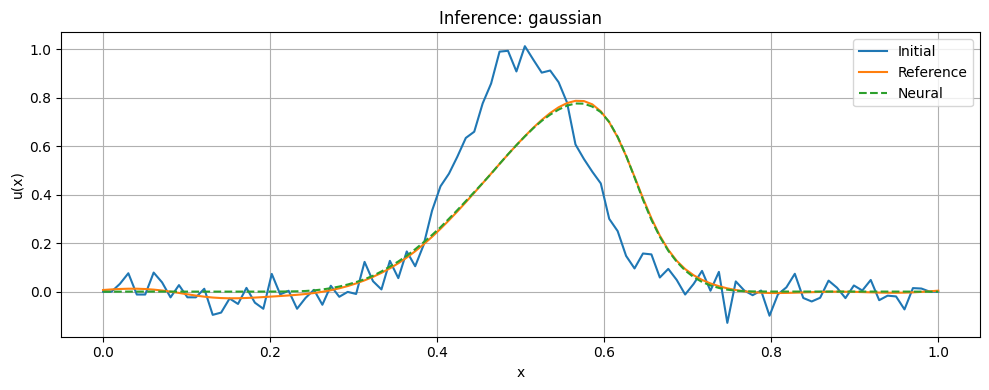

In [96]:
_,_ = inference('gaussian', noise=True)

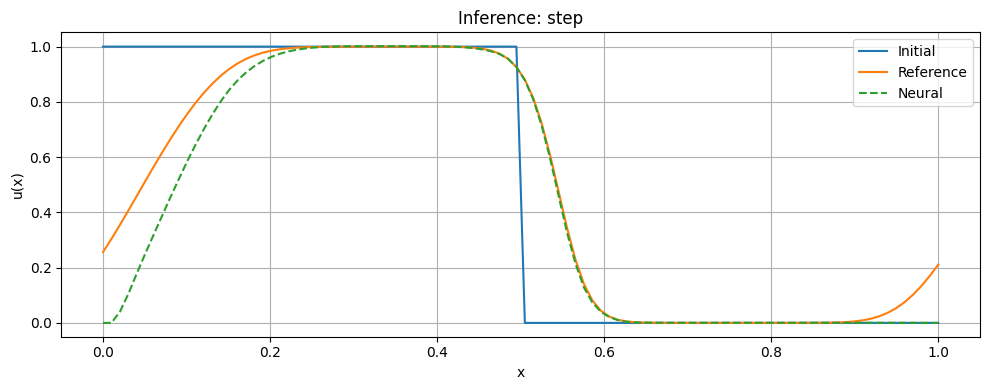

In [97]:
_,_ = inference('step', noise=False)

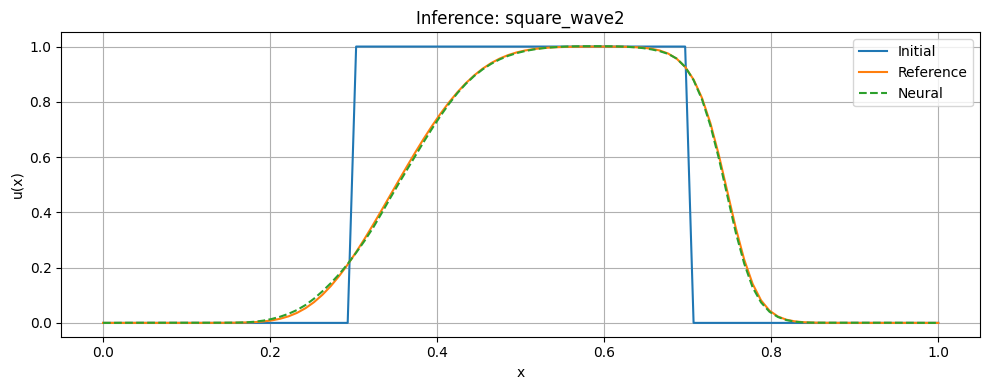

In [17]:
_,_ = inference('square_wave2', noise=False)

# Linear interpolation on the whole coarse gird

In [ ]:
def run_on_coarse_grid_upsample_then_model(N_coarse=25, initial_type='sine', pg=False, plot=True, alpha=0.01):
    # Grid setup
    x_coarse = np.linspace(0, 1, N_coarse)
    x_fine = np.linspace(0, 1, 100)
    dx_fine = x_fine[1] - x_fine[0]

    dt_fine = dt
    steps = int(t_end / dt_fine)

    print(f"Running model with upsampling:")
    print(f"N_coarse = {N_coarse}, N_fine = 100, dt = {dt_fine:.6f}, steps = {steps}")

    def interpolate_to_fine(u_coarse):
        return np.interp(x_fine, x_coarse, u_coarse)

    def interpolate_to_coarse(u_fine):
        return np.interp(x_coarse, x_fine, u_fine)

    # Initial condition
    u_init_coarse = get_initial_condition(initial_type, x_coarse)
    u_fine = interpolate_to_fine(u_init_coarse)
    u_fine_init = u_fine.copy()
    u_ref_coarse = u_init_coarse.copy()

    # Model rollout on fine grid
    for _ in range(steps):
        u_fine = run_fixed_point_step(u_fine, model, mean, std, dx_fine, dt_fine, pg=pg, alpha=alpha)
    # Reference: numerical on coarse grid
    u_ref_coarse = rollout_reference_solution(u_ref_coarse, x_coarse[1] - x_coarse[0], dt_fine, nu, t_end)

    # Convert model output back to coarse resolution
    u_model_coarse = interpolate_to_coarse(u_fine)

    if plot:
        # Coarse grid comparison
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_init_coarse, label='Initial')
        plt.plot(x_coarse, u_ref_coarse, label='Reference (coarse)')
        plt.plot(x_coarse, u_model_coarse, label='Model (interp)', linestyle='--')
        plt.plot(x_fine, u_fine, label='Model (fine)', linestyle='dotted')
        plt.title("Model Inference (Upsampled from Coarse Grid)")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()

    return u_model_coarse, u_ref_coarse, u_fine

Running model with upsampling:
N_coarse = 25, N_fine = 100, dt = 0.001000, steps = 100


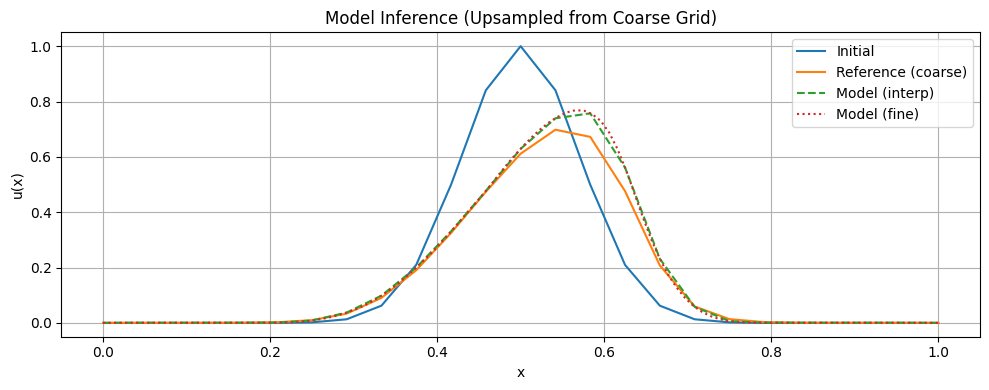

In [ ]:
_, _, u_fine = run_on_coarse_grid_upsample_then_model(N_coarse=25, initial_type='gaussian')

Running model with upsampling:
N_coarse = 5, N_fine = 100, dt = 0.001000, steps = 100
Running model with upsampling:
N_coarse = 10, N_fine = 100, dt = 0.001000, steps = 100
Running model with upsampling:
N_coarse = 25, N_fine = 100, dt = 0.001000, steps = 100
Running model with upsampling:
N_coarse = 50, N_fine = 100, dt = 0.001000, steps = 100
Running model with upsampling:
N_coarse = 100, N_fine = 100, dt = 0.001000, steps = 100


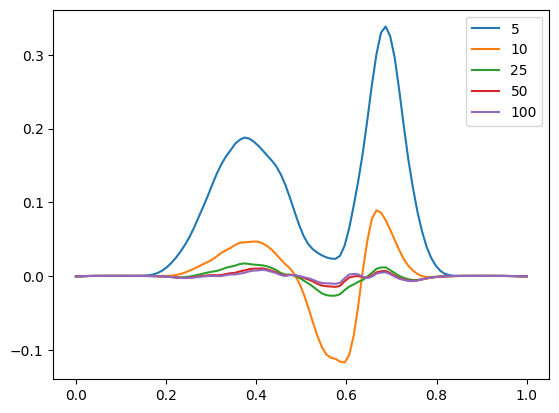

In [ ]:
grid_sizes = [5, 10, 25, 50, 100]

condition = "gaussian"

for grid_size in grid_sizes:
  _, _, u_fine = run_on_coarse_grid_upsample_then_model(N_coarse=grid_size, initial_type=condition, plot=False)
  _, _, u_ref= generate_initial_conditions(condition)
  u_ref = rollout_reference_solution(u_ref, dx, dt, nu, t_end)

  fine_ref_diff = u_fine - u_ref
  plt.plot(x, fine_ref_diff, label=f"{grid_size}")

plt.legend()
plt.show()

Running model with upsampling:
N_coarse = 10, N_fine = 100, dt = 0.001000, steps = 100


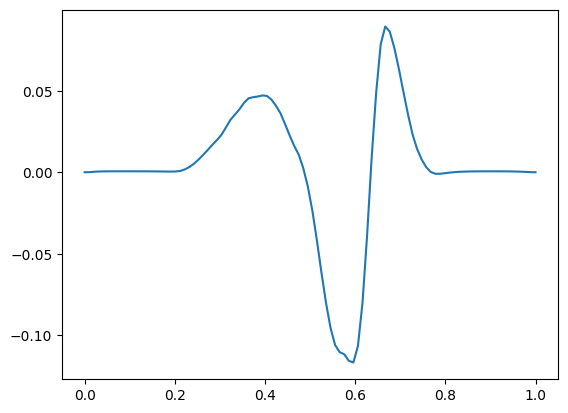

In [ ]:
condition = "gaussian"
_, _, u_fine = run_on_coarse_grid_upsample_then_model(N_coarse=10, initial_type=condition, plot=False)
_, _, u_ref= generate_initial_conditions(condition)
u_ref = rollout_reference_solution(u_ref, dx, dt, nu, t_end)




fine_ref_diff = u_fine - u_ref
plt.plot(x, fine_ref_diff)
plt.show()


Running model with upsampling:
N_coarse = 10, N_fine = 100, dt = 0.001000, steps = 100


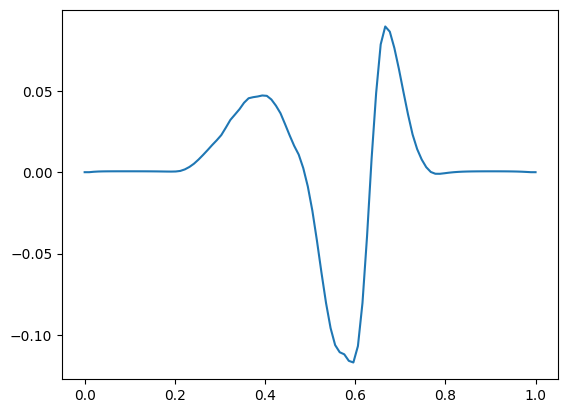

In [ ]:
condition = "gaussian"
_, _, u_fine = run_on_coarse_grid_upsample_then_model(N_coarse=10, initial_type=condition, plot=False, pg=True)
_, _, u_ref= generate_initial_conditions(condition)
u_ref = rollout_reference_solution(u_ref, dx, dt, nu, t_end)

diff = u_fine - u_ref
plt.plot(x, diff)
plt.show()


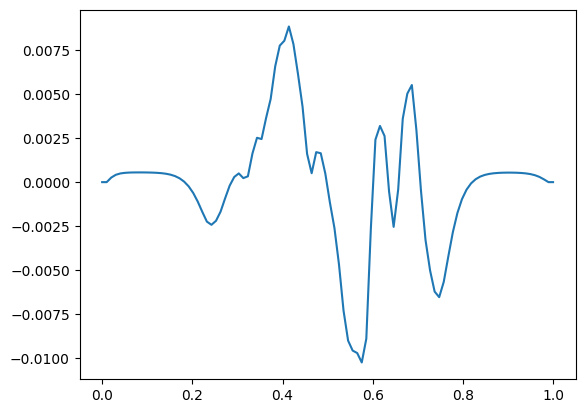

In [ ]:
u_correct,_ = inference(initial_type=condition, noise=False, plot=False)

_, _, u_ref= generate_initial_conditions(condition)
u_ref = rollout_reference_solution(u_ref, dx, dt, nu, t_end)

diff = u_correct - u_ref
plt.plot(x, diff)
plt.show()

Running model with upsampling:
N_coarse = 10, N_fine = 100, dt = 0.001000, steps = 100
Running model with upsampling:
N_coarse = 10, N_fine = 100, dt = 0.001000, steps = 100


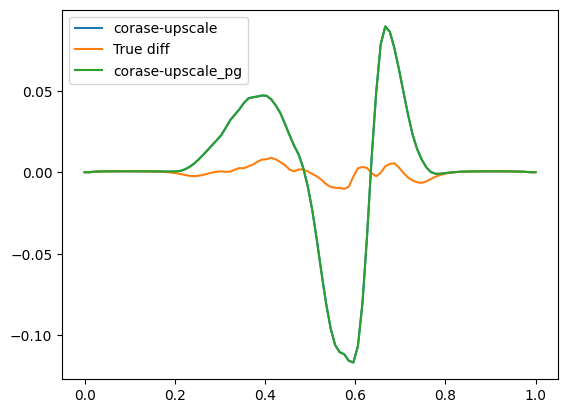

In [ ]:
condition = "gaussian"
_, _, u_fine = run_on_coarse_grid_upsample_then_model(N_coarse=10, initial_type=condition, plot=False)
u_correct,_ = inference(initial_type=condition, noise=False, plot=False)
_, _, u_fine_pg = run_on_coarse_grid_upsample_then_model(N_coarse=10, initial_type=condition, plot=False, pg=True)


_, _, u_ref= generate_initial_conditions(condition)
u_ref = rollout_reference_solution(u_ref, dx, dt, nu, t_end)




fine_ref_diff = u_fine - u_ref
cor_ref_diff = u_correct - u_ref
fine_pg_ref_diff = u_fine_pg - u_ref
plt.plot(x, fine_ref_diff, label="corase-upscale")
plt.plot(x, cor_ref_diff, label="True diff")
plt.plot(x, fine_pg_ref_diff, label="corase-upscale_pg")
plt.legend()
plt.show()

Running model with upsampling:
N_coarse = 10, N_fine = 100, dt = 0.001000, steps = 100


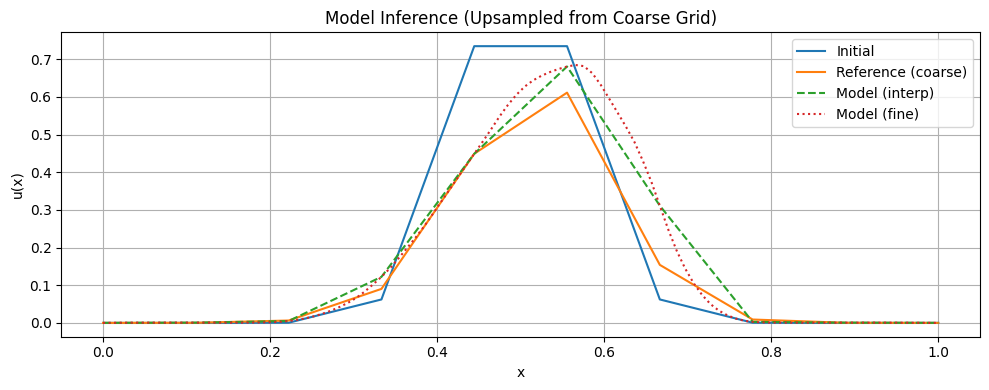

(array([0.00000000e+00, 5.68293142e-04, 5.00036637e-03, 1.22143881e-01,
        4.48708125e-01, 6.80373711e-01, 3.11015173e-01, 2.72837195e-03,
        5.53414118e-04, 0.00000000e+00]),
 array([0.00000000e+00, 2.47710416e-04, 6.28055869e-03, 9.02182759e-02,
        4.48917693e-01, 6.11112691e-01, 1.53944967e-01, 8.93480796e-03,
        3.11838814e-04, 0.00000000e+00]),
 array([0.00000000e+00, 0.00000000e+00, 2.59391923e-04, 4.16319807e-04,
        4.93098961e-04, 5.28624669e-04, 5.44852760e-04, 5.52489969e-04,
        5.56602921e-04, 5.59657848e-04, 5.63115003e-04, 5.68293142e-04,
        5.76630416e-04, 5.90384352e-04, 6.13123815e-04, 6.50854072e-04,
        7.13946499e-04, 8.20260563e-04, 1.00206562e-03, 1.31946790e-03,
        1.89190991e-03, 2.97912061e-03, 5.00036637e-03, 8.01633031e-03,
        1.21276683e-02, 1.75454484e-02, 2.42400582e-02, 3.22615114e-02,
        4.18296293e-02, 5.28860220e-02, 6.61078033e-02, 8.28313152e-02,
        1.02027135e-01, 1.22143881e-01, 1.44795865e-

In [ ]:
run_on_coarse_grid_upsample_then_model(N_coarse=10, initial_type=condition, plot=True, pg=True)


#Polynomial interpolation on the whole grid

## Output = N_fine


In [24]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from scipy.interpolate import CubicSpline, make_interp_spline, BarycentricInterpolator


import numpy as np
import torch

# ──────────────────────────────────────────────────────────────
# 1.  Petrov-Galerkin dissipation (1-D) – matches white-paper text
# ──────────────────────────────────────────────────────────────
def pg_dissipation_2(u_high, u_prev, i, dx, dt,
                            nu_fd=0.10, alpha_k1=0.25, eps_k=1e-5):
    """
    PG stabilization inspired by CFD vector code:
    - Computes low-order prediction
    - Computes residual and directional gradient
    - Builds k_eff
    - Constructs diffusion term: 0.5*(kΔu + Δ(ku) - uΔk)
    """

    # --- Low-order (upwind + ν) prediction ---
    u = u_prev
    dudx  = (u[i] - u[i-1]) / dx
    d2udx = (u[i+1] - 2*u[i] + u[i-1]) / dx**2
    u_low = u[i] - dt * u[i] * dudx + dt * nu_fd * d2udx

    # --- Residual ---
    R = u_high[i] - u_low

    # --- Central gradient |∇u| ---
    grad = (u[i+1] - u[i-1]) / (2*dx)

    # --- PG coefficient k_i ---
    k1 = alpha_k1 * abs(R) / (eps_k + abs(grad))
    k_max = 0.25 / dt
    k_i = min(k1, k_max)

    # --- Estimate at neighbors ---
    def k_local(j):
        dudx_j = (u[j] - u[j-1]) / dx
        d2udx_j = (u[j+1] - 2*u[j] + u[j-1]) / dx**2
        u_low_j = u[j] - dt * u[j] * dudx_j + dt * nu_fd * d2udx_j
        R_j = u_high[j] - u_low_j
        grad_j = (u[j+1] - u[j-1]) / (2 * dx)
        return min(alpha_k1 * abs(R_j) / (eps_k + abs(grad_j)), k_max)

    k_p = k_local(i+1)
    k_m = k_local(i-1)

    # --- Discrete Laplacians ---
    lap_u  = (u_high[i+1] - 2*u_high[i] + u_high[i-1]) / dx**2
    lap_ku = (k_p*u_high[i+1] - 2*k_i*u_high[i] + k_m*u_high[i-1]) / dx**2
    lap_k  = (k_p - 2*k_i + k_m) / dx**2

    # --- PG dissipation term ---
    return 0.5 * (k_i * lap_u + lap_ku - u_high[i] * lap_k)



# ------------------------------------------------------------
# Reference solver (for comparison)
# ------------------------------------------------------------
def upwind_step(u, dx, dt, nu):
    u = u.copy()
    dudx  = (u - np.roll(u, 1)) / dx
    d2udx = (np.roll(u, -1) - 2*u + np.roll(u, 1)) / dx**2
    return u - dt * u * dudx + dt * nu * d2udx

# ------------------------------------------------------------
# Interpolate from coarse (25) to fine (100) using spline or lagrange
# ------------------------------------------------------------
def spline_interpolate_to_fine(u_coarse, x_coarse, x_fine, kind='bspline'):
    if kind == 'bspline':
        spline_fn = make_interp_spline(x_coarse, u_coarse, k=5)
        return spline_fn(x_fine)
    elif kind == 'cubic':
        spline_fn = CubicSpline(x_coarse, u_coarse)
        return spline_fn(x_fine)
    elif kind == 'lagrange':
        interp_fn = BarycentricInterpolator(x_coarse, u_coarse)
        return interp_fn(x_fine)
    else:
        raise ValueError("Unknown interpolation type. Use 'bspline', 'cubic', or 'lagrange'.")

# ------------------------------------------------------------
# Apply NN on fine grid using fixed-point iteration
# ------------------------------------------------------------
def apply_nn_on_fine_grid(u_fine, model, mean, std,
                          dt_fine, steps=1,
                          pg=True, alpha=0.25,
                          nu_low=0.10,          # upwind-only residual
                          dx=None):
    """
    Run the NN solver on the *fine* grid.  If pg=True,
    add Petrov-Galerkin dissipation computed by pg_dissipation_updated.
    """
    if dx is None:
        dx = 1.0 / (len(u_fine) - 1)

    u_next = u_fine.copy()
    for _ in range(steps):
        u_work = u_next.copy()          # Gauss–Seidel style

        for i in range(2, len(u_fine)-2):
            # stencil: 5 from current level + 4 guessed next-level values
            s_curr = u_next[i-2:i+3]
            s_next = u_work[i-2:i+3]
            stencil = np.hstack([s_curr, s_next[[0,1,3,4]]])

            tensor = torch.tensor([stencil], dtype=torch.float32,
                                  device=mean.device)
            tensor = (tensor - mean) / std
            with torch.no_grad():
                pred_hi = model(tensor).item()

            if pg:
                diss = pg_dissipation_2(
                          u_high = u_work,      # latest field with pred_hi included
                          u_prev = u_next,      # field before current sweep
                          i      = i,
                          dx     = 1/24,
                          dt     = 0.04,
                          alpha_k1 = alpha,
                          nu_fd    = nu_low
                       )
                u_work[i] = pred_hi + dt_fine * diss
            else:
                u_work[i] = pred_hi

        u_next = u_work                # advance to next outer step

    return u_next




# ------------------------------------------------------------
# Full pipeline
# ------------------------------------------------------------
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

def interpolate_and_apply_nn(condition, base_model, mean, std,
                             t_end=1.0, dt_fine=0.001,
                             interpolation='bspline', pg=False, alpha=0.01,
                             plot=True, nu=0.01):
    u0_coarse = get_initial_condition(condition, np.linspace(0, 1, 25))
    u0_fine = get_initial_condition(condition, np.linspace(0, 1, 100) )
    u_fd_fine = u0_fine.copy()

    N_fine = 100
    x_fine = np.linspace(0, 1, N_fine)
    dx_fine = x_fine[1] - x_fine[0]

    N_coarse = len(u0_coarse)
    x_coarse = np.linspace(0, 1, N_coarse)
    dx_coarse = x_coarse[1] - x_coarse[0]

    u_fd = spline_interpolate_to_fine(u0_coarse, x_coarse, x_fine, interpolation)
    u_nn = u_fd.copy()
    u_init = u_fd.copy()

    steps = int(np.round(t_end / dt_fine))
    base_model.eval()

    # Store time snapshots for animation
    history_nn = [u_nn.copy()]
    history_fd = [u_fd_fine.copy()]
    error = []
    for _ in range(steps):
        u_nn = apply_nn_on_fine_grid(
          u_nn, base_model, mean, std,
          dt_fine       = dt_fine,
          steps         = 1,
          pg            = pg,       # turn PG on/off here
          alpha         = 0.25,       # α_k1  (paper suggests 0.25 γ)
          nu_low        = 0.01,        # low-order viscosity in residual
          dx            = dx_fine
      )
        u_fd_fine = upwind_step(u_fd_fine, dx_fine, dt_fine, nu=nu)
        history_nn.append(u_nn.copy())
        history_fd.append(u_fd_fine.copy())
        error.append(u_nn - u_fd_fine)

    # Animation plot
    if plot:
        fig, ax = plt.subplots(figsize=(9, 4))
        line_fd, = ax.plot(x_fine, history_fd[0], label='FD Reference', lw=2)
        line_nn, = ax.plot(x_fine, history_nn[0], label=f'NN on fine ({interpolation})', lw=2, ls='--')
        ax.scatter(x_coarse, u0_coarse, color='black', s=20, label='Coarse Grid Points')
        ax.set_title(f"Interpolation = {interpolation}")
        ax.set_xlabel("x")
        ax.set_ylabel("u(x)")
        ax.grid()
        ax.set_ylim(min(u_init)-0.1, max(u_init)+0.1)
        ax.legend()

        def animate(frame):
            line_fd.set_ydata(history_fd[frame])
            line_nn.set_ydata(history_nn[frame])
            return line_fd, line_nn

        anim = FuncAnimation(fig, animate, frames=len(history_nn), interval=30, blit=True)
        plt.close(fig)  # Prevent static plot
        display(HTML(anim.to_jshtml()))

    return u_init, u_nn, u_fd, x_fine, error


def animate_error(error):
  x = np.linspace(0, 1, len(error[0]))

  fig, ax = plt.subplots(figsize=(9, 4))
  line_error, = ax.plot(x, error[0], label='error', lw=2)
  ax.set_xlabel("x")
  ax.set_ylabel("error")
  ax.grid()
  ax.set_ylim(min(error[-1])-0.1, max(error[-1])+0.1)
  ax.legend()

  def animate(frame):
      line_error.set_ydata(error[frame])

      return line_error,

  anim = FuncAnimation(fig, animate, frames=len(error), interval=30, blit=True)
  plt.close(fig)  # Prevent static plot
  display(HTML(anim.to_jshtml()))
  return

def compare_animate_error(error1, error2):
  x = np.linspace(0, 1, len(error1[0]))

  fig, ax = plt.subplots(figsize=(9, 4))
  line_error1, = ax.plot(x, error1[0], label='error1', lw=2)
  line_error2, = ax.plot(x, error2[0], label='error2', lw=2)

  ax.set_xlabel("x")
  ax.set_ylabel("error")
  ax.grid()
  ax.set_ylim(min(error[-1])-0.1, max(error[-1])+0.1)
  ax.legend()

  def animate(frame):
      line_error1.set_ydata(error1[frame])
      line_error2.set_ydata(error2[frame])

      return line_error1, line_error2

  anim = FuncAnimation(fig, animate, frames=len(error1), interval=30, blit=True)
  plt.close(fig)  # Prevent static plot
  display(HTML(anim.to_jshtml()))
  return

In [25]:
condition = "sine"
_, nn, _ , _, error= interpolate_and_apply_nn(
    condition,
    model, mean, std,
    t_end=0.1, dt_fine=0.001,
    interpolation='bspline',  # or 'cubic'
    pg=False,
    plot=True
)

<ipython-input-24-3541095536>:112: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  tensor = torch.tensor([stencil], dtype=torch.float32,


In [ ]:
animate_error(error)

In [ ]:
condition = "sawtooth"
_, nn, _ , _, error_normal= interpolate_and_apply_nn(
    condition,
    model, mean, std,
    t_end=0.1, dt_fine=0.001,
    interpolation='bspline',  # or 'cubic'
    pg=False,
    plot=True
)

# animate_error(error)

In [ ]:
condition = "sawtooth"
_, nn, _ , _ , error_pg = interpolate_and_apply_nn(
    condition,
    model, mean, std,
    t_end=0.1, dt_fine=0.001,
    interpolation='bspline',  # or 'cubic'
    pg=True,
    plot=True
)

# animate_error(error)

In [ ]:
compare_animate_error(error_normal, error_pg)

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from scipy.interpolate import CubicSpline, make_interp_spline, BarycentricInterpolator

# ------------------------------------------------------------
# Reference solver (for comparison)
# ------------------------------------------------------------
def upwind_step(u, dx, dt, nu):
    u = u.copy()
    dudx  = (u - np.roll(u, 1)) / dx
    d2udx = (np.roll(u, -1) - 2*u + np.roll(u, 1)) / dx**2
    return u - dt * u * dudx + dt * nu * d2udx

# ------------------------------------------------------------
# Interpolate from coarse (25) to fine (100) using spline or lagrange
# ------------------------------------------------------------
def spline_interpolate_to_fine(u_coarse, x_coarse, x_fine, kind='bspline'):
    if kind == 'bspline':
        spline_fn = make_interp_spline(x_coarse, u_coarse, k=5)
        return spline_fn(x_fine)
    elif kind == 'cubic':
        spline_fn = CubicSpline(x_coarse, u_coarse)
        return spline_fn(x_fine)
    elif kind == 'lagrange':
        interp_fn = BarycentricInterpolator(x_coarse, u_coarse)
        return interp_fn(x_fine)
    else:
        raise ValueError("Unknown interpolation type. Use 'bspline', 'cubic', or 'lagrange'.")

# ------------------------------------------------------------
# Apply NN on fine grid using fixed-point iteration
# ------------------------------------------------------------
def apply_nn_on_fine_grid(u_fine, model, mean, std, dt_fine, steps=1, pg=False, alpha=0.01, nu=0.01):
    u_next = u_fine.copy()
    for _ in range(steps):
        u_new = u_next.copy()
        for i in range(2, len(u_fine)-2):
            s_curr = u_fine[i-2:i+3]
            s_next = u_next[i-2:i+3]
            stencil = np.concatenate([s_curr, s_next[[0, 1, 3, 4]]])  # shape (9,)
            tensor = torch.tensor([stencil], dtype=torch.float32, device=mean.device)
            tensor = (tensor - mean) / std
            with torch.no_grad():
                pred = model(tensor).item()
            if pg:
                diss = pg_dissipation(pred, u_next, i, 0.01, dt_fine, nu=nu, alpha=alpha)
                u_new[i] = pred + dt_fine * diss
            else:
                u_new[i] = pred
        # u_new[:2] = u_new[-2:] = 0
        u_next = u_new
    return u_next




# ------------------------------------------------------------
# Full pipeline
# ------------------------------------------------------------
def interpolate_and_apply_nn(u0_coarse, base_model, mean, std,
                             t_end=1.0, dt_fine=0.001,
                             interpolation='bspline', pg=False, alpha=0.01,
                             plot=True):
    # set up the same environment as interpolation operator
    N_fine = 100
    x_fine = np.linspace(0, 1, N_fine)
    dx_fine = x_fine[1] - x_fine[0]


    # set up the parameters for the coarse grid
    N_coarse = len(u0_coarse)
    x_coarse = np.linspace(0, 1, N_coarse)
    dx_coarse = x_coarse[1] - x_coarse[0]

    ratio = int(dx_coarse/dx_fine)
    dt_coarse = ratio * dt_fine

    # Interpolate coarse initial to fine grid
    u_fd = spline_interpolate_to_fine(u0_coarse, x_coarse, x_fine, interpolation)
    u_nn = u_fd.copy()
    u_init = u_fd.copy()

    steps = int(np.round(t_end / dt_coarse))
    base_model.eval()


    u_fd_coarse = u0_coarse.copy()

    print(f"dx_fine:", dx_fine)
    print(f"dx_coarse:", dx_coarse)
    print(f"ratio:", ratio)

    for _ in range(steps):
        #u_nn = apply_nn_on_coarse_grid(u_nn, u base_model, mean, std, dt_fine, steps=1, pg=pg, alpha=alpha)
        # for i in range(ratio):
        #   u_nn = apply_nn_on_fine_grid(u_nn, base_model, mean, std, dt_fine, steps=1, pg=pg, alpha=alpha)
        u_fd_coarse = upwind_step(u_fd_coarse, dx_coarse, dt_coarse, nu=nu)

    if plot:
        plt.figure(figsize=(9, 4))
        # plt.plot(x_fine, u_init, label='Interpolated Initial (fine)', alpha=0.4)
        plt.plot(x_coarse, u_fd_coarse, label='FD Reference', lw=2)
        # plt.plot(x_fine, u_nn, label=f'NN on fine ({interpolation})', lw=2, ls='--')
        plt.scatter(x_coarse, u0_coarse, color='black', s=20, label='Coarse Grid Points')
        plt.scatter(x_fine, u_fd, color='red', s=20, label='FD Points')
        plt.title(f"Interpolation = {interpolation}, N_coarse = {N_coarse}, N_fine = {N_fine}")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.grid()
        plt.legend()
        plt.tight_layout()
        plt.show()

    return u_init, u_nn, u_fd, x_fine

dx_fine: 0.010101010101010102
dx_coarse: 0.041666666666666664
ratio: 4


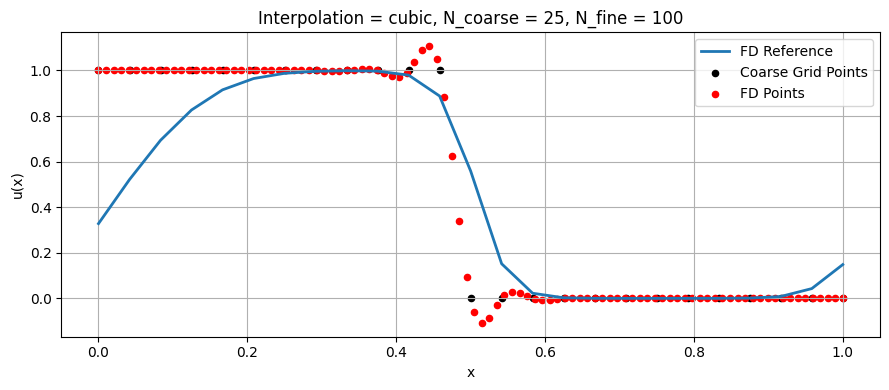

In [ ]:
u0 = get_initial_condition("step", np.linspace(0, 1, 25))
_, _, _, _ = interpolate_and_apply_nn(
    u0,
    model, mean, std,
    t_end=0.1, dt_fine=0.001,
    interpolation='cubic',  # or 'cubic'
    pg=False,
    plot=True
)

# Linear Interpolation on the coarse grid point only



In [ ]:
  from scipy.interpolate import interp1d

  def interp_run_fixed_point_step(u_current, base_model, mean, std, dx, dt, dx_fine, dt_fine, pg=False, alpha=0.01):
      """
      Perform one full time step using fixed-point iterations with or without PG.
      Uses local interpolation around each coarse grid point to emulate fine resolution stencils.
      """
      u_next = u_current.copy()
      N = len(u_current)
      x_coarse = np.linspace(0, 1, N)
      gamma = dx_fine / dx

      # Define interpolation functions at each step
      for _ in range(5):  # fixed-point iteration
          u_new = u_next.copy()

          # Create interpolation functions for current and next time steps
          interp_curr = interp1d(x_coarse, u_current, kind='linear', fill_value='extrapolate')
          interp_next = interp1d(x_coarse, u_next, kind='linear', fill_value='extrapolate')

          for i in range(2, N - 2):  # avoid boundaries
              x_i = x_coarse[i]

              # Virtual fine-grid stencil locations around x_i (e.g. ±2dx_fine)
              local_x = np.array([
                  x_i - 2*dx_fine, x_i - dx_fine, x_i, x_i + dx_fine, x_i + 2*dx_fine
              ])
              local_x_next = np.array([
                  x_i - dx_fine, x_i - dx_fine/2, x_i + dx_fine/2, x_i + dx_fine
              ])

              # Interpolated values at those stencil points
              stencil_curr = interp_curr(local_x)
              stencil_next = interp_next(local_x_next)

              stencil = np.concatenate([stencil_curr, stencil_next])
              stencil_tensor = torch.tensor([stencil], dtype=torch.float32, device=device)
              stencil_tensor = (stencil_tensor - mean.to(device)) / std.to(device)

              pred = base_model(stencil_tensor).item()

              if pg:
                  diss = pg_dissipation(pred, u_current, i, dx, dt, nu, alpha=alpha)
                  u_new[i] = pred + dt * diss
              else:
                  u_new[i] = (1 - gamma) * u_current[i] + gamma * pred

          u_new[0:2] = u_new[-2:] = 0  # Dirichlet boundary
          u_next = u_new.copy()
      return u_next


  def local_interpolation_inference(N_coarse=25, initial_type='sine', pg=False, plot=True, alpha=0.01):
      # Grid setup
      x_coarse = np.linspace(0, 1, N_coarse)
      dx_coarse = x_coarse[1] - x_coarse[0]
      x_fine = np.linspace(0, 1, 100)
      dx_fine = x_fine[1] - x_fine[0]
      dt_fine = dt
      steps = int(t_end / dt_fine)

      print(f"Running model with upsampling:")
      print(f"N_coarse = {N_coarse}, N_fine = 100, dt = {dt_fine:.6f}, steps = {steps}")

      def interpolate_to_fine(u_coarse):
          return np.interp(x_fine, x_coarse, u_coarse)

      def interpolate_to_coarse(u_fine):
          return np.interp(x_coarse, x_fine, u_fine)

      # Initial condition
      u_init_coarse = get_initial_condition(initial_type, x_coarse)
      #u_fine = interpolate_to_fine(u_init_coarse)
      #u_fine_init = u_fine.copy()
      u_coarse = u_init_coarse.copy()
      u_ref_coarse = u_init_coarse.copy()

      # Model rollout on fine grid
      for _ in range(steps):
          u_coarse = interp_run_fixed_point_step(u_coarse, base_model, mean, std, dx_coarse, dt_fine, dx_fine, dt_fine, pg=pg, alpha=alpha)
      # Reference: numerical on coarse grid
      u_ref_coarse = rollout_reference_solution(u_ref_coarse, x_coarse[1] - x_coarse[0], dt_fine, nu, t_end)

      # Convert model output back to coarse resolution
      #u_model_coarse = interpolate_to_coarse(u_fine)

      if plot:
          # Coarse grid comparison
          plt.figure(figsize=(10, 4))
          plt.plot(x_coarse, u_init_coarse, label='Initial')
          plt.plot(x_coarse, u_ref_coarse, label='Reference (coarse)')
          plt.plot(x_coarse, u_coarse, label='Model (interp)', linestyle='--')
          #plt.plot(x_fine, u_fine, label='Model (fine)', linestyle='dotted')
          plt.title("Model Inference (Upsampled from Coarse Grid)")
          plt.xlabel("x")
          plt.ylabel("u(x)")
          plt.grid(True)
          plt.legend()
          plt.tight_layout()
          plt.show()

      return u_ref_coarse, u_coarse

Running model with upsampling:
N_coarse = 25, N_fine = 100, dt = 0.001000, steps = 100


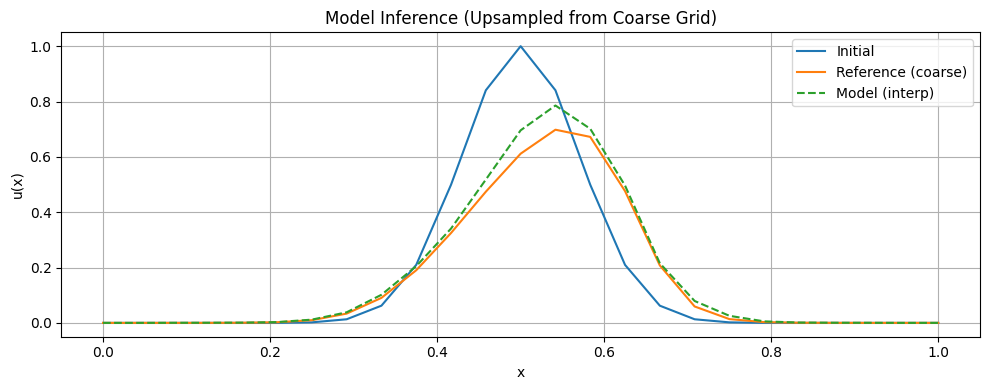

(array([0.00000000e+00, 1.11947019e-06, 9.52229996e-06, 6.94785927e-05,
        4.32948744e-04, 2.26549578e-03, 9.74282117e-03, 3.35515154e-02,
        9.03759682e-02, 1.90238553e-01, 3.24826676e-01, 4.74048701e-01,
        6.11474064e-01, 6.98116378e-01, 6.72157162e-01, 4.76220116e-01,
        2.07567172e-01, 5.92971168e-02, 1.36107961e-02, 2.72575395e-03,
        4.79098123e-04, 7.34919144e-05, 9.82993617e-06, 1.14041185e-06,
        0.00000000e+00]),
 array([0.00000000e+00, 0.00000000e+00, 2.78047698e-04, 4.25406987e-04,
        8.62885926e-04, 2.88094698e-03, 1.17357777e-02, 3.82210844e-02,
        1.01567926e-01, 2.04941744e-01, 3.40897064e-01, 5.17883587e-01,
        6.95897878e-01, 7.85574192e-01, 7.01511960e-01, 4.96199241e-01,
        2.15379600e-01, 7.91257359e-02, 2.55077591e-02, 5.46373283e-03,
        1.23038182e-03, 4.75744125e-04, 2.85982163e-04, 0.00000000e+00,
        0.00000000e+00]))

In [ ]:
local_interpolation_inference(N_coarse=25, initial_type="gaussian")

In [ ]:
from scipy.interpolate import interp1d
import numpy as np
import matplotlib.pyplot as plt
import torch

def adaptive_interp_run_fixed_point_step(u_fine, x_fine, base_model, mean, std, coarse_spacing, dx_fine, dt_fine, pg=False, alpha=0.01):
    u_next = u_fine.copy()
    N = len(u_fine)
    coarse_stride = int(round(coarse_spacing / dx_fine))
    coarse_indices = np.arange(2, N - 2, coarse_stride)

    for _ in range(5):  # fixed-point iteration
        u_new = u_next.copy()
        interp_curr = interp1d(x_fine, u_fine, kind='linear', fill_value='extrapolate')
        interp_next = interp1d(x_fine, u_next, kind='linear', fill_value='extrapolate')

        for i in coarse_indices:
            x_i = x_fine[i]
            stencil_x_curr = np.array([
                x_i - 2*dx_fine, x_i - dx_fine, x_i, x_i + dx_fine, x_i + 2*dx_fine
            ])
            stencil_x_next = np.array([
                x_i - dx_fine, x_i - dx_fine/2, x_i + dx_fine/2, x_i + dx_fine
            ])
            stencil_curr = interp_curr(stencil_x_curr)
            stencil_next = interp_next(stencil_x_next)
            stencil = np.concatenate([stencil_curr, stencil_next])

            stencil_tensor = torch.tensor([stencil], dtype=torch.float32)
            stencil_tensor = (stencil_tensor - mean) / std
            pred = base_model(stencil_tensor).item()

            if pg:
                diss = pg_dissipation(pred, u_fine, i, dx_fine, dt_fine, nu=0.01, alpha=alpha)
                u_new[i] = pred + dt_fine * diss
            else:
                u_new[i] = pred

        u_new[0:2] = u_new[-2:] = 0
        u_next = u_new.copy()

    return u_next


def adaptive_local_interpolation_inference(u_coarse_init, base_model, mean, std, t_end, dt_fine, pg=False, alpha=0.01, plot=True):
    N_coarse = len(u_coarse_init)
    x_coarse = np.linspace(0, 1, N_coarse)
    x_fine = np.linspace(0, 1, 100)
    dx_fine = x_fine[1] - x_fine[0]
    coarse_spacing = x_coarse[1] - x_coarse[0]
    steps = int(t_end / dt_fine)

    interp_fn = interp1d(x_coarse, u_coarse_init, kind='linear', fill_value='extrapolate')
    u_fine = interp_fn(x_fine)
    u_fine_init = u_fine.copy()

    for _ in range(steps):
        u_fine = adaptive_interp_run_fixed_point_step(u_fine, x_fine, base_model, mean, std, coarse_spacing, dx_fine, dt_fine, pg=pg, alpha=alpha)

    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x_fine, u_fine_init, label='Initial (interpolated)')
        plt.plot(x_fine, u_fine, label='Model (updated fine)', linestyle='--')
        plt.title("Sparse Application of Model at Coarse Points (on Fine Grid)")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()

    return u_fine_init, u_fine, x_fine

In [ ]:
u0 = get_initial_condition("gaussian", np.linspace(0, 1, 50))
adaptive_local_interpolation_inference(
    u_coarse_init=u0,
    base_model=model.to("cpu"),
    mean=mean.to("cpu"),
    std=std.to('cpu'),
    t_end=0.1,
    dt_fine=1e-3,
    pg=False,
    alpha=0.01,
)

In [ ]:
from scipy.interpolate import interp1d
import numpy as np
import matplotlib.pyplot as plt
import torch

def interpolate_per_point(u_coarse, x_coarse, x_fine, base_model, mean, std, coarse_spacing, dx_fine, dt_fine, pg=False, alpha=0.01):

    u_next = u_coarse.copy()
    N = len(u_coarse)
    dx_coarse = x_coarse[1] - x_coarse[0]
    dx_fine = x_fine[1] - x_fine[0]
    coarse_length = len(x_coarse)
    dx_dx_c = dx_fine / dx_coarse


    for _ in range(5):  # fixed-point iteration
        u_new = u_next.copy()

        for i in range(1, coarse_length-1):
            x_i = x_fine[i]
            stencil_x_curr = np.array([
                x_i - 2*dx_fine, x_i - dx_fine, x_i, x_i + dx_fine, x_i + 2*dx_fine
            ])
            stencil_x_next = np.array([
                x_i - dx_fine, x_i - dx_fine/2, x_i + dx_fine/2, x_i + dx_fine
            ])


            #current
            u_i = u_coarse[i]

            stencil_curr = np.array([u_coarse[i] - 2 * dx_dx_c * (u_coarse[i] - u_coarse[i - 1]),
                                     u_coarse[i] - dx_dx_c * (u_coarse[i] - u_coarse[i - 1]),
                                     u_coarse[i],
                                     u_coarse[i] - dx_dx_c * (u_coarse[i] - u_coarse[i + 1]),
                                     u_coarse[i] - 2 * dx_dx_c * (u_coarse[i] - u_coarse[i + 1])])


            stencil_next = np.array([u_next[i] - 2 * dx_dx_c * (u_next[i] - u_next[i - 1]),
                                     u_next[i] - dx_dx_c * (u_next[i] - u_next[i - 1]),

                                     u_next[i] - dx_dx_c * (u_next[i] - u_next[i + 1]),
                                     u_next[i] - 2 * dx_dx_c * (u_next[i] - u_next[i + 1])])






            stencil = np.concatenate([stencil_curr, stencil_next])

            stencil_tensor = torch.tensor([stencil], dtype=torch.float32)
            stencil_tensor = (stencil_tensor - mean) / std
            pred = base_model(stencil_tensor).item()

            if pg:
                diss = pg_dissipation(pred, u_fine, i, dx_fine, dt_fine, nu=0.01, alpha=alpha)
                u_new[i] = pred + dt_fine * diss
            else:
                u_new[i] = pred

        u_new[0:1] = u_new[-1:] = 0
        u_next = u_new.copy()

    return u_next


def local_interpolation_inference(u_coarse_init, base_model, mean, std, t_end, dt_fine, pg=False, alpha=0.01, plot=True):
    N_coarse = len(u_coarse_init)
    x_coarse = np.linspace(0, 1, N_coarse)
    x_fine = np.linspace(0, 1, 100)
    dx_fine = x_fine[1] - x_fine[0]
    coarse_spacing = x_coarse[1] - x_coarse[0]
    steps = 4* int(t_end / dt_fine)

    interp_fn = interp1d(x_coarse, u_coarse_init, kind='linear', fill_value='extrapolate')
    u_fine = interp_fn(x_fine)
    u_fine_init = u_fine.copy()

    for _ in range(steps):
        u_coarse = interpolate_per_point(u_coarse_init, x_coarse, x_fine, base_model, mean, std, coarse_spacing, dx_fine, dt_fine, pg=pg, alpha=alpha)

    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_coarse_init, label='Initial (interpolated)')
        plt.plot(x_coarse, u_coarse, label='Model (updated fine)', linestyle='--')
        plt.title("Sparse Application of Model at Coarse Points (on Fine Grid)")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()

    return u_fine_init, u_fine, x_fine

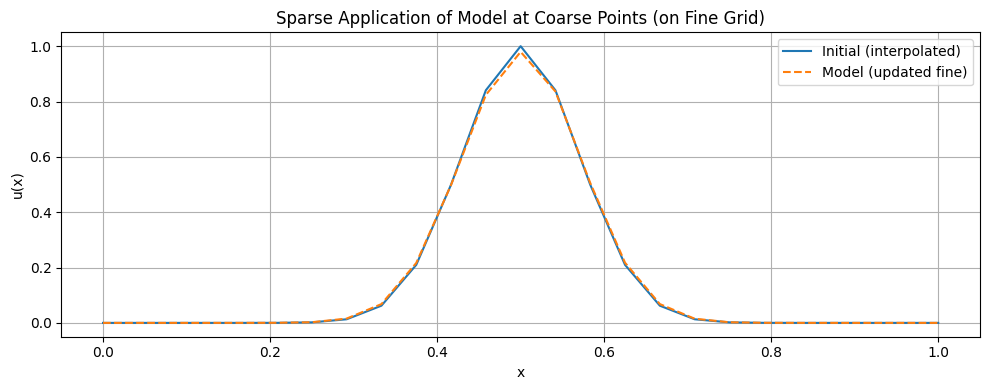

(array([1.38879439e-11, 1.93068713e-10, 3.72249482e-10, 5.51430252e-10,
        7.30611021e-10, 6.71325024e-09, 1.35249550e-08, 2.03366597e-08,
        2.71483644e-08, 1.65632682e-07, 3.48007869e-07, 5.30383057e-07,
        7.12758245e-07, 2.92723827e-06, 6.36098120e-06, 9.79472413e-06,
        1.32284671e-05, 3.76259386e-05, 8.29871387e-05, 1.28348339e-04,
        1.73709539e-04, 3.59187002e-04, 7.78191571e-04, 1.19719614e-03,
        1.61620071e-03, 2.60333009e-03, 5.29483393e-03, 7.98633776e-03,
        1.06778416e-02, 1.45221080e-02, 2.64357120e-02, 3.83493160e-02,
        5.02629200e-02, 6.21765240e-02, 9.79183090e-02, 1.33660094e-01,
        1.69401879e-01, 2.05143664e-01, 2.71071472e-01, 3.41311570e-01,
        4.11551667e-01, 4.81791764e-01, 5.61401235e-01, 6.44133830e-01,
        7.26866425e-01, 8.09599020e-01, 8.64771661e-01, 9.03408329e-01,
        9.42044998e-01, 9.80681666e-01, 9.80681666e-01, 9.42044998e-01,
        9.03408329e-01, 8.64771661e-01, 8.09599020e-01, 7.268664

In [ ]:
u0 = get_initial_condition("gaussian", np.linspace(0, 1, 25))
local_interpolation_inference(
    u_coarse_init=u0,
    base_model=model.to("cpu"),
    mean=mean.to("cpu"),
    std=std.to('cpu'),
    t_end=0.1,
    dt_fine=1e-3,
    pg=False,
    alpha=0.01,
)

# Polynomial interpolation piecewise


In [102]:
def flatten_without_duplicates(all_x, all_u):
    flat_x = []
    flat_u = []

    for idx, (x_seg, u_seg) in enumerate(zip(all_x, all_u)):
        if idx == 0:
            flat_x.extend(x_seg)
            flat_u.extend(u_seg)
        else:
            flat_x.extend(x_seg[1:])   # skip first point
            flat_u.extend(u_seg[1:])

    return np.array(flat_x), np.array(flat_u)

def interpolate_per_point1(N_grid, initial_condition, N_fine_grid=100, t_end=0.1, dt_fine=0.01):
  #set up the basic variables
  x_coarse = np.linspace(0, 1, N_grid)
  dx_coarse = x_coarse[1] - x_coarse[0]
  x_fine = np.linspace(0, 1, N_fine_grid)
  dx_fine = x_fine[1] - x_fine[0]

  u0_coarse = get_initial_condition(initial_condition, x_coarse)
  u0_fine = get_initial_condition(initial_condition, x_fine)

  # variables needed for interpolation
  # using the 2 closest point on coarse to interpolate the 5 points
  ratio = int(dx_coarse/dx_fine)
  interp_num = 2*ratio + 1

  all_u = []
  all_x = []
  for point in range(1, N_grid-1, 1):
    #interpolate the points needed to match the dx

    x = np.array([x_coarse[point-1], x_coarse[point], x_coarse[point+1]])
    u = np.array([u0_coarse[point-1], u0_coarse[point], u0_coarse[point+1]])

    spline = make_interp_spline(x, u, k=2)
    x_interp = np.linspace(x[0], x[-1], interp_num)
    u_interp = spline(x_interp)

    all_x.append(x_interp)
    all_u.append(u_interp)


  plt.figure(figsize=(10, 5))
  for x_interp, u_interp in zip(all_x, all_u):
      plt.plot(x_interp, u_interp, alpha=0.6)
  plt.scatter(x_coarse, u0_coarse, color='black', label='Coarse grid', zorder=5)
  plt.title("Local interpolations across all coarse points")
  plt.xlabel("x")
  plt.ylabel("u")
  plt.grid(True)
  plt.legend()
  plt.tight_layout()
  plt.show()





  # plt.figure(figsize=(10, 4))
  # plt.plot(x_coarse, u0_coarse, label='Coarse Grid Points')
  # plt.plot(x_fine, u0_fine, label='Fine Grid Points')

  return all_x, all_u


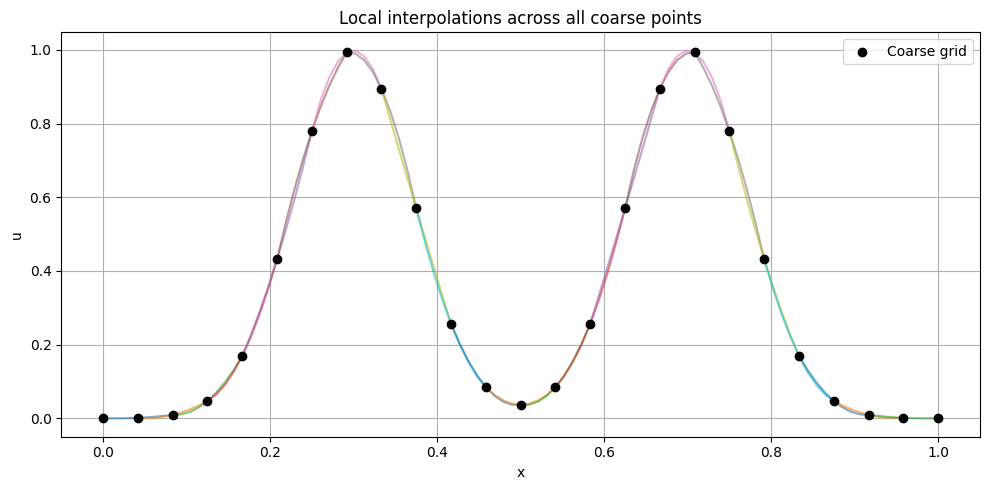

In [104]:
all_x , all_u = interpolate_per_point1(25, "double_gaussian")

In [106]:
len(all_u)
len(all_x)

12

In [109]:
len(all_u[0])
all_u[6]
all_x[6]

array([0.5       , 0.51041667, 0.52083333, 0.53125   , 0.54166667,
       0.55208333, 0.5625    , 0.57291667, 0.58333333])

In [105]:
def upwind_step(u, dx, dt, nu):
    u = u.copy()
    dudx  = (u - np.roll(u, 1)) / dx
    d2udx = (np.roll(u, -1) - 2*u + np.roll(u, 1)) / dx**2
    return u - dt * u * dudx + dt * nu * d2udx

def flatten_without_duplicates(all_x, all_u):
    flat_x = []
    flat_u = []

    for idx, (x_seg, u_seg) in enumerate(zip(all_x, all_u)):
        if idx == 0:
            flat_x.extend(x_seg)
            flat_u.extend(u_seg)
        else:
            flat_x.extend(x_seg[1:])   # skip first point
            flat_u.extend(u_seg[1:])

    return np.array(flat_x), np.array(flat_u)


def interpolate_per_point(u_coarse, N_fine_grid=100, t_end=0.1, dt_fine=0.01):


  N_grid = len(u_coarse)
  x_coarse = np.linspace(0, 1, N_grid)
  dx_coarse = x_coarse[1] - x_coarse[0]
  x_fine = np.linspace(0, 1, N_fine_grid)
  dx_fine = x_fine[1] - x_fine[0]


  # variables needed for interpolation
  # using the 2 closest point on coarse to interpolate the 5 points
  ratio = int(dx_coarse/dx_fine)
  interp_num = 2*ratio + 1

  all_u = []
  all_x = []
  for point in range(1, N_grid-1, 1):
    #interpolate the points needed to match the dx

    x = np.array([x_coarse[point-1], x_coarse[point], x_coarse[point+1]])
    u = np.array([u_coarse[point-1], u_coarse[point], u_coarse[point+1]])

    spline = make_interp_spline(x, u, k=2)
    x_interp = np.linspace(x[0], x[-1], interp_num)
    u_interp = spline(x_interp)

    all_x.append(x_interp)
    all_u.append(u_interp)


  return all_x, all_u

def apply_per_point(N_grid, initial_condition, N_fine_grid=100, t_end=0.1, dt_fine=0.01, model=model, mean=mean, std=std):
    model = model.to(device)
    mean = mean.to(device)
    std = std.to(device)
    # Set up coarse and fine grids
    x_coarse = np.linspace(0, 1, N_grid)
    dx_coarse = x_coarse[1] - x_coarse[0]
    x_fine = np.linspace(0, 1, N_fine_grid)
    dx_fine = x_fine[1] - x_fine[0]

    u0_coarse = get_initial_condition(initial_condition, x_coarse)
    u_upwind_ref = u0_coarse.copy()
    u_jacobi = u0_coarse.copy()

    coarse_begin, coarse_end = u0_coarse[0], u0_coarse[-1]

    # Interpolation setup
    ratio = int(dx_coarse / dx_fine)
    interp_num = 2 * ratio + 1
    centre_idx = ratio
    n_steps = int(t_end / dt_fine)
    for _ in range(n_steps):
        for _ in range(ratio):
            # 5 Jacobi iterations
            for _ in range(5):
                all_x, all_u = interpolate_per_point(u_jacobi, N_fine_grid=N_fine_grid)

                u_new = [coarse_begin]
                for point in range(len(all_u)):
                    current_stencil = all_u[point][centre_idx - 2:centre_idx + 3]
                    next_stencil = all_u[point][[centre_idx - 2, centre_idx - 1, centre_idx + 1, centre_idx + 2]]

                    stencil = np.concatenate([current_stencil, next_stencil])
                    tensor = torch.tensor([stencil], dtype=torch.float32, device=mean.device)
                    tensor = (tensor - mean) / std

                    with torch.no_grad():
                        pred = model(tensor).item()

                    u_new.append(pred)

                u_new.append(coarse_end)
                u_jacobi = np.array(u_new)

        # Reference upwind update
        u_upwind_ref = upwind_step(u_upwind_ref, dx_coarse, dt_fine, nu)

    # Final interpolation for plotting
    centre_idx = (all_u[0].shape[0] // 2)  # middle index in each fine patch
    extracted_from_interp = [u[centre_idx] for u in all_u]
    extracted_from_interp = [u_jacobi[0]] + extracted_from_interp + [u_jacobi[-1]]
    print(len(extracted_from_interp))
    # Plot
    plt.figure(figsize=(10, 5))

    # Plot original coarse grid input
    plt.scatter(x_coarse, u0_coarse, color='black', label='Initial Coarse Grid', marker='x', s=30)

    # Plot NN coarse predictions extracted from interpolation
    plt.plot(x_coarse, extracted_from_interp, label='Extracted Coarse from Interp', linestyle='-', linewidth=2, color='blue')

    # Plot finite difference reference
    plt.plot(x_coarse, u_upwind_ref, label='FD Reference', linestyle='--', linewidth=2, color='orange')

    # Labels and formatting
    plt.title("Comparison of NN Output, Interpolated Values, and FD Reference")
    plt.xlabel("x")
    plt.ylabel("u(x)")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()
    return all_x, all_u


In [106]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def apply_per_point_animated(N_grid, initial_condition, N_fine_grid=100, t_end=0.1, dt_fine=0.001, model=model, mean=mean, std=std, pg=False):
    model = model.to(device)
    mean = mean.to(device)
    std = std.to(device)
    # Set up coarse and fine grids
    x_coarse = np.linspace(0, 1, N_grid)
    dx_coarse = x_coarse[1] - x_coarse[0]
    x_fine = np.linspace(0, 1, N_fine_grid)
    dx_fine = x_fine[1] - x_fine[0]

    u0_coarse = get_initial_condition(initial_condition, x_coarse)
    u_upwind_ref = u0_coarse.copy()
    u_jacobi = u0_coarse.copy()

    coarse_begin, coarse_end = u0_coarse[0], u0_coarse[-1]

    ratio = int(dx_coarse / dx_fine)

    interp_num = 2 * ratio + 1
    centre_idx = ratio
    dt_coarse = ratio * dt_fine
    n_steps = int(t_end / dt_coarse)
    print("t_end", t_end)
    print("dt_fine", dt_fine)
    print("dt_coarse", dt_coarse)
    print("n_steps", n_steps)
    print("ratio", ratio)

    nn_history = []
    fd_history = []
    error_history = []

    nn_history.append(u_jacobi.copy())
    fd_history.append(u_upwind_ref.copy())
    error_history.append(abs(u_jacobi - u_upwind_ref))

    for _ in range(n_steps):
        for _ in range(1):
            # 5 Jacobi iterations
            for _ in range(5):
                all_x, all_u = interpolate_per_point(u_jacobi, N_fine_grid=N_fine_grid)
                u_new = [coarse_begin]
                for point in range(len(all_u)):
                    current_stencil = all_u[point][centre_idx - 2:centre_idx + 3]
                    next_stencil = all_u[point][[centre_idx - 2, centre_idx - 1, centre_idx + 1, centre_idx + 2]]
                    stencil = np.concatenate([current_stencil, next_stencil])

                    tensor = torch.tensor([stencil], dtype=torch.float32, device=mean.device)
                    tensor = (tensor - mean) / std
                    with torch.no_grad():
                        pred = model(tensor).item()


                        if pg == True:
                          left = all_u[point][0]
                          centre = all_u[point][centre_idx]
                          right = all_u[point][-1]

                          k_max = 0.25/dt_coarse

                          alpha = 0.125
                          grad_u = (right - left)/(dx_coarse * 2)
                          k_eff = alpha * abs(pred - centre) / (1e-3 + grad_u)
                          k = min(k_max, k_eff)

                          diss = k * (left - 2*centre + right)/(dx_coarse ** 2)

                          pred = pred + dt_coarse * diss


                    u_new.append(pred)

                u_new.append(coarse_end)
                u_jacobi = np.array(u_new)

        # Reference upwind update
        u_upwind_ref = upwind_step(u_upwind_ref, dx_coarse, dt_coarse, nu)

        # Save current coarse outputs
        nn_history.append(u_jacobi.copy())
        fd_history.append(u_upwind_ref.copy())
        error_history.append(abs(u_jacobi - u_upwind_ref))

    # ─────────────────────────────
    # Animate the result
    # ─────────────────────────────
    fig, ax = plt.subplots(figsize=(10, 5))
    line_nn, = ax.plot([], [], label="NN", color="blue")
    line_fd, = ax.plot([], [], label="FD Ref", linestyle='--', color="orange")
    scatter_init = ax.scatter(x_coarse, u0_coarse, color='black', label='Initial', marker='x', s=30)

    ax.set_xlim(0, 1)
    ax.set_ylim(np.min(nn_history[0]) - 0.1, np.max(nn_history[0]) + 0.1)
    ax.set_xlabel("x")
    ax.set_ylabel("u(x)")
    ax.set_title("Evolution: NN vs FD (Coarse Grid)")
    ax.grid(True)
    ax.legend()

    def update(frame):
        line_nn.set_data(x_coarse, nn_history[frame])
        line_fd.set_data(x_coarse, fd_history[frame])
        return line_nn, line_fd, scatter_init

    anim = FuncAnimation(fig, update, frames=len(nn_history), interval=75, blit=True)
    plt.close(fig)
    display(HTML(anim.to_jshtml()))

    return nn_history, fd_history, x_coarse, error_history

In [113]:
nn_hist, fd_hist, x_coarse, error_history_pg = apply_per_point_animated(25, "double_gaussian", pg=True)


t_end 0.1
dt_fine 0.001
dt_coarse 0.004
n_steps 25
ratio 4


In [108]:
nn_hist, fd_hist, x_coarse, error_history_normal = apply_per_point_animated(25, "double_gaussian", pg=False)

t_end 0.1
dt_fine 0.001
dt_coarse 0.004
n_steps 25
ratio 4


In [110]:
fig, ax = plt.subplots(figsize=(10, 5))
line_error_pg, = ax.plot([], [], label="PG", color="blue")
line_error_normal, = ax.plot([], [], label="Normal", linestyle='--', color="orange")




ax.set_xlim(0, 1)
ax.set_ylim(np.min(error_history_pg[0]) - 0.05, np.max(error_history_pg[0]) + 0.1)
ax.set_xlabel("x")
ax.set_ylabel("u(x)")
ax.set_title("Evolution: NN vs FD (Coarse Grid)")
ax.grid(True)
ax.legend()

def update(frame):
    line_error_pg.set_data(x_coarse, error_history_pg[frame])
    line_error_normal.set_data(x_coarse, error_history_normal[frame])
    return line_error_pg, line_error_normal

anim = FuncAnimation(fig, update, frames=len(error_history_pg), interval=75, blit=True)
plt.close(fig)
display(HTML(anim.to_jshtml()))

In [78]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from scipy.interpolate import make_interp_spline

# ------------------------------------------------------------
# Reference finite difference (1st-order upwind + diffusion)
# ------------------------------------------------------------
def upwind_step(u, dx, dt, nu):
    u = u.copy()
    dudx  = (u - np.roll(u, 1)) / dx
    d2udx = (np.roll(u, -1) - 2*u + np.roll(u, 1)) / dx**2
    return u - dt * u * dudx + dt * nu * d2udx

# ------------------------------------------------------------
# One NN step with 3-point quadratic B-spline interpolation
# ------------------------------------------------------------
def interpolate_step_bspline(u_coarse, model, mean, std,
                             dx_coarse, dx_fine, dt_fine):

    N = len(u_coarse)
    r = dx_fine / dx_coarse
    u_next = u_coarse.copy()

    for _ in range(5):  # Jacobi iterations
        for i in range(1, N - 1):  # Need 3-point stencil: i-1, i, i+1
            u3_now  = u_coarse[i - 1:i + 2]
            u3_next = u_next[i - 1:i + 2]

            # Local domain for interpolation
            x_local = np.linspace(-1, 1, 3)
            spline_now  = make_interp_spline(x_local, u3_now,  k=2)
            spline_next = make_interp_spline(x_local, u3_next, k=2)

            # Interpolate to 5 locations: [-1, -0.5, 0, 0.5, 1]
            s_now  = spline_now (np.array([-1, -0.5, 0.0, 0.5, 1]))
            s_next = spline_next(np.array([-0.5, -1.0, 1.0, 0.5]))  # 4 points excluding center

            stencil = np.concatenate([s_now, s_next])

            tensor = torch.tensor([stencil], dtype=torch.float32, device=mean.device)
            tensor = (tensor - mean) / std

            with torch.no_grad():
                pred = model(tensor).item()

            u_next[i] = pred

        # Optionally enforce boundary values
        u_next[0]  = 0.0
        u_next[-1] = 0.0

    return u_next

# ------------------------------------------------------------
# Full Inference Loop (Coarse grid + spline interpolation)
# ------------------------------------------------------------
def run_bspline_nn_solver(u0_coarse, model, mean, std,
                          t_end, dt_fine,
                          dx_fine=0.01,
                          nu=0.01,
                          plot=True):

    N = len(u0_coarse)
    x_coarse = np.linspace(0.0, 1.0, N)
    dx_coarse = x_coarse[1] - x_coarse[0]
    ratio = max(1, int(round(dx_coarse / dx_fine)))
    dt_phys = ratio * dt_fine
    n_steps = int(round(t_end / dt_phys))

    u_nn   = u0_coarse.copy()
    u_fd   = u0_coarse.copy()
    u_init = u0_coarse.copy()

    model.eval()

    print(f"[INFO] Coarse N={N}, dx={dx_coarse:.4f}, dt={dt_phys:.4f}, fine_ratio={ratio}, steps={n_steps}")

    for _ in range(n_steps):
        for _ in range(ratio):
            u_nn = interpolate_step_bspline(u_nn, model, mean, std,
                                            dx_coarse, dx_fine, dt_fine)

        u_fd = upwind_step(u_fd, dx_coarse, dt_phys, nu)

    if plot:
        plt.figure(figsize=(9, 4))
        plt.plot(x_coarse, u_init, label="Initial", alpha=0.4)
        plt.plot(x_coarse, u_fd,   label="FD Reference", lw=2)
        plt.plot(x_coarse, u_nn,   label="NN (quadratic B-spline)", lw=2, ls="--")
        plt.xlabel("x")
        plt.ylabel("u")
        plt.grid()
        plt.legend()
        plt.tight_layout()
        plt.show()

    return u_init, u_nn, u_fd, x_coarse

[INFO] Coarse N=25, dx=0.0417, dt=0.0040, fine_ratio=4, steps=25


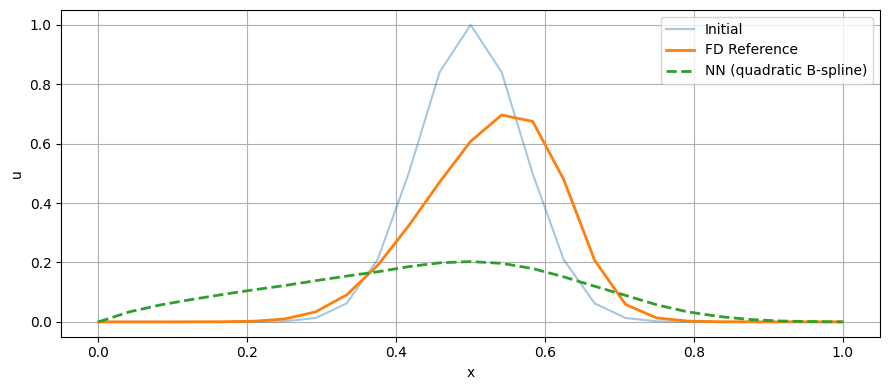

(array([1.38879439e-11, 7.53008617e-10, 2.88512906e-08, 7.81148941e-07,
        1.49453385e-05, 2.02060289e-04, 1.93045414e-03, 1.30329074e-02,
        6.21765240e-02, 2.09611387e-01, 4.99351789e-01, 8.40623743e-01,
        1.00000000e+00, 8.40623743e-01, 4.99351789e-01, 2.09611387e-01,
        6.21765240e-02, 1.30329074e-02, 1.93045414e-03, 2.02060289e-04,
        1.49453385e-05, 7.81148941e-07, 2.88512906e-08, 7.53008617e-10,
        1.38879439e-11]),
 array([0.        , 0.03388595, 0.05712501, 0.07529334, 0.09218276,
        0.10789225, 0.12222402, 0.13857526, 0.15418279, 0.16867277,
        0.18588039, 0.19883481, 0.20306437, 0.19706398, 0.17948943,
        0.15161788, 0.11986904, 0.08907197, 0.05748581, 0.0337243 ,
        0.01815699, 0.00802873, 0.00287976, 0.00089469, 0.        ]),
 array([1.00599905e-07, 9.59433952e-07, 8.54557432e-06, 6.50520536e-05,
        4.18027923e-04, 2.23353227e-03, 9.72647485e-03, 3.36766754e-02,
        9.06656448e-02, 1.90059799e-01, 3.23147575e-01, 

In [50]:
u0 = get_initial_condition("gaussian", np.linspace(0, 1, 25))
run_bspline_nn_solver(u0, model, mean, std, t_end=0.1, dt_fine=0.001)

In [38]:
import numpy as np
import torch
import matplotlib.pyplot as plt

from scipy.interpolate import make_interp_spline



# ------------------------------------------------------------
# Reference finite difference (1st-order upwind + diffusion)
# ------------------------------------------------------------
def upwind_step(u, dx, dt, nu):
    u = u.copy()
    dudx  = (u - np.roll(u, 1)) / dx
    d2udx = (np.roll(u, -1) - 2*u + np.roll(u, 1)) / dx**2
    return u - dt * u * dudx + dt * nu * d2udx

# ------------------------------------------------------------
# Lagrange interpolation weights generator
# ------------------------------------------------------------
def lagrange_weights(offsets, nodes):
    offsets = np.asarray(offsets, dtype=float)
    nodes   = np.asarray(nodes, dtype=float)
    W = np.empty((len(offsets), len(nodes)))

    for m, δ in enumerate(offsets):
        for j, xj in enumerate(nodes):
            num = np.prod(δ - np.delete(nodes, j))
            den = np.prod(xj - np.delete(nodes, j))
            W[m, j] = num / den
    return W

# ------------------------------------------------------------
# One NN step with interpolation at each coarse node
# ------------------------------------------------------------
def interpolate_per_point(u_coarse, base_model, mean, std,
                          dx_coarse, dx_fine, dt_fine,
                          interpolation='lagrange',
                          pg=False, alpha=0.01, nu=0.01):

    N      = len(u_coarse)
    r      = dx_fine / dx_coarse
    u_next = u_coarse.copy()

    if interpolation == 'lagrange':
        offsets_curr = np.array([-2, -1, 0, 1, 2]) * r
        offsets_next = np.array([-2, -1, 1, 2]) * r
        nodes        = np.array([-2, -1, 0, 1, 2])
        W_curr       = lagrange_weights(offsets_curr, nodes)  # (5,5)
        W_next       = lagrange_weights(offsets_next, nodes)  # (4,5)

    for _ in range(5):
        for i in range(2, N-2):  # need 5 coarse nodes centered at i

            if interpolation == 'lagrange':
                u5_curr = u_coarse[i-2:i+3]  # shape (5,)
                u5_next = u_next[i-2:i+3]   # shape (5,)
                s_curr = W_curr @ u5_curr   # (5,)
                s_next = W_next @ u5_next   # (4,)
                stencil = np.concatenate([s_curr, s_next])

            elif interpolation == 'linear':
                du_L   = u_coarse[i]   - u_coarse[i-1]
                du_R   = u_coarse[i+1] - u_coarse[i]
                s_curr = [u_coarse[i] - 2*r*du_L,
                          u_coarse[i] -   r*du_L,
                          u_coarse[i],
                          u_coarse[i] +   r*du_R,
                          u_coarse[i] + 2*r*du_R]

                duL_n  = u_next[i]   - u_next[i-1]
                duR_n  = u_next[i+1] - u_next[i]
                s_next = [u_next[i] - 2*r*duL_n,
                          u_next[i] -   r*duL_n,
                          u_next[i] +   r*duR_n,
                          u_next[i] + 2*r*duR_n]
                stencil = s_curr + s_next

            elif interpolation == 'bspline':
                x_nodes = np.linspace(-2, 2, 5)
                spline_curr = make_interp_spline(x_nodes, u_coarse[i-2:i+3], k=3)
                spline_next = make_interp_spline(x_nodes, u_next[i-2:i+3],  k=3)

                s_curr = spline_curr(r * np.array([-2, -1, 0, 1, 2]))
                s_next = spline_next(r * np.array([-2, -1, 1, 2]))
                stencil = np.concatenate([s_curr, s_next])

            stencil_tensor = torch.tensor([stencil], dtype=torch.float32, device=mean.device)
            stencil_tensor = (stencil_tensor - mean) / std

            with torch.no_grad():
                pred = base_model(stencil_tensor).item()

            if pg:
                diss = pg_dissipation(pred, u_next, i, dx_coarse, dt_fine, nu=nu, alpha=alpha)
                u_next[i] = pred + dt_fine * diss
            else:
                u_next[i] = pred

        u_next[:1]  = 0.0
        u_next[-1:] = 0.0

    return u_next
# ------------------------------------------------------------
# NN Inference Loop — solves on coarse grid with interpolation
# ------------------------------------------------------------
def local_interpolation_inference(u0_coarse, base_model, mean, std,
                                  t_end, dt_fine,
                                  dx_fine = 0.01,
                                  nu=0.01, pg=False, alpha=0.01,
                                  interpolation='lagrange',
                                  plot=True):

    N           = len(u0_coarse)
    x_coarse    = np.linspace(0.0, 1.0, N)
    dx_coarse   = x_coarse[1] - x_coarse[0]
    nx_ratio    = max(1, int(round(dx_coarse / dx_fine)))
    dt_phys     = nx_ratio * dt_fine
    n_phys      = int(round(t_end / dt_phys))

    u_nn   = u0_coarse.copy()
    u_fd   = u0_coarse.copy()
    u_init = u0_coarse.copy()

    base_model.eval()

    print(f"[INFO] Grid = {N}, dx = {dx_coarse:.5f}, dt = {dt_phys:.5f}, steps = {n_phys}, method = {interpolation}")

    for _ in range(n_phys):
        for _ in range(nx_ratio):
            u_nn = interpolate_per_point(u_nn, base_model, mean, std,
                                         dx_coarse, dx_fine, dt_fine,
                                         interpolation, pg, alpha, nu)

        u_fd = upwind_step(u_fd, dx_coarse, dt_phys, nu)

    if plot:
        plt.figure(figsize=(9,4))
        plt.plot(x_coarse, u_init, label='Initial', alpha=.4)
        plt.plot(x_coarse, u_fd,   label='FD Reference', lw=2)
        plt.plot(x_coarse, u_nn,   label=f'NN ({interpolation})', lw=2, ls='--')
        plt.grid(); plt.legend(); plt.tight_layout(); plt.show()

    return u_init, u_nn, u_fd, x_coarse

In [41]:
u0 = get_initial_condition("sine", np.linspace(0, 1, 25))
temp = np.linspace(0, 1, 100)
u_init, u_nn_b, u_fd_b, x = local_interpolation_inference(
    u0,
    model.to(device), mean.to(device), std.to(device),
    t_end = 0.1,
    dt_fine = 0.001,     # the network’s trained dt
    dx_fine = temp[1] - temp[0],      # the network’s trained dx
    interpolation='bspline',   #cubic
    pg=False, alpha=0.01,
    plot=False)

# _, u_nn_l, u_fd_l, _ = local_interpolation_inference(
#     u0,
#     model.to(device), mean.to(device), std.to(device),
#     t_end = 0.1,
#     dt_fine = 0.001,     # the network’s trained dt
#     dx_fine = temp[1] - temp[0],      # the network’s trained dx
#     interpolation='lagrange',   #cubic
#     pg=False, alpha=0.01,
#     plot=False)

# _, u_nn_linear, u_fd_linear, _ = local_interpolation_inference(
#     u0,
#     model.to(device), mean.to(device), std.to(device),
#     t_end = 0.1,
#     dt_fine = 0.001,     # the network’s trained dt
#     dx_fine = temp[1] - temp[0],      # the network’s trained dx
#     interpolation='linear',   #cubic
#     pg=False, alpha=0.01,
#     plot=False)




[INFO] Grid = 25, dx = 0.04167, dt = 0.00400, steps = 25, method = bspline
[INFO] Grid = 25, dx = 0.04167, dt = 0.00400, steps = 25, method = lagrange
[INFO] Grid = 25, dx = 0.04167, dt = 0.00400, steps = 25, method = linear


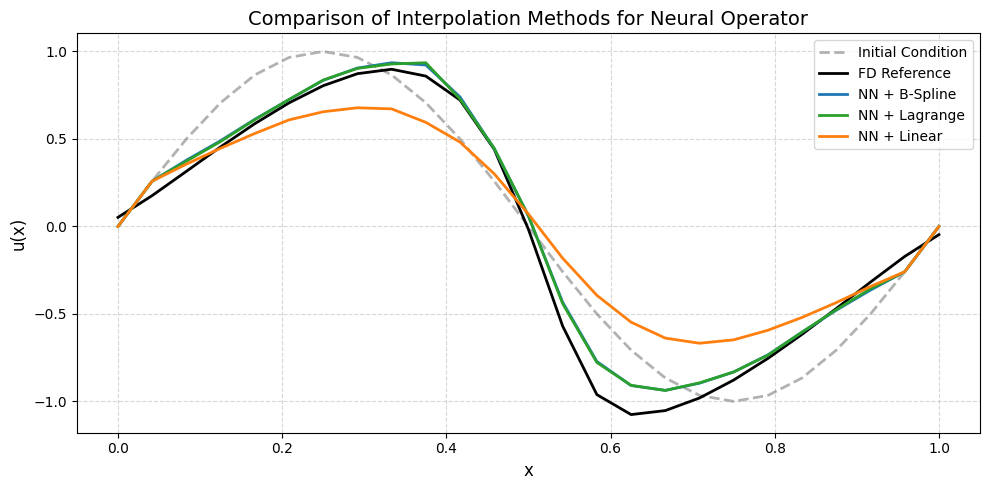

In [42]:
plt.figure(figsize=(10, 5))

plt.plot(x, u_init, label='Initial Condition', color='gray', linestyle='--', linewidth=2, alpha=0.6)
plt.plot(x, u_fd_b, label='FD Reference', color='black', linewidth=2)
plt.plot(x, u_nn_b, label='NN + B-Spline', color='tab:blue', linewidth=2)
plt.plot(x, u_nn_l, label='NN + Lagrange', color='tab:green', linewidth=2)
plt.plot(x, u_nn_linear, label='NN + Linear', color='tab:orange', linewidth=2)

plt.title("Comparison of Interpolation Methods for Neural Operator", fontsize=14)
plt.xlabel("x", fontsize=12)
plt.ylabel("u(x)", fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend(fontsize=10, loc='best')
plt.tight_layout()
plt.show()

In [ ]:
def visualize_bspline_interpolation(u, i, dx_coarse, r):
    """
    Visualize B-spline interpolation used at coarse node i.
    Shows interpolated smooth curve and evaluation stencil points.
    """
    x_nodes = np.linspace(-2, 2, 5)
    u_nodes = u[i-2:i+3]

    # Build cubic B-spline
    spline = make_interp_spline(x_nodes, u_nodes, k=3)

    # Evaluation grid for smooth plot
    x_dense = np.linspace(-2, 2, 200)
    y_dense = spline(x_dense)

    # Evaluate spline at interpolation stencil points
    x_interp = r * np.array([-2, -1, 0, 1, 2])
    y_interp = spline(x_interp)

    # Plot
    plt.figure(figsize=(8, 4))
    plt.plot(x_dense, y_dense, label='Cubic B-spline (smooth)', color='blue')
    plt.scatter(x_nodes, u_nodes, color='black', label='Coarse Grid Nodes')
    plt.scatter(x_interp, y_interp, color='red', label='Interpolated Points (Stencil)')
    plt.title(f"B-spline Interpolation Around Node {i}")
    plt.xlabel("Local coordinate")
    plt.ylabel("Interpolated value")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from scipy.interpolate import make_interp_spline  # <-- Added for B-spline interpolation

# ------------------------------------------------------------
# Reference finite difference (1st-order upwind + diffusion)
# ------------------------------------------------------------
def upwind_step(u, dx, dt, nu):
    u = u.copy()
    dudx  = (u - np.roll(u, 1)) / dx
    d2udx = (np.roll(u, -1) - 2*u + np.roll(u, 1)) / dx**2
    return u - dt * u * dudx + dt * nu * d2udx

# ------------------------------------------------------------
# Lagrange interpolation weights generator
# ------------------------------------------------------------
def lagrange_weights(offsets, nodes):
    offsets = np.asarray(offsets, dtype=float)
    nodes   = np.asarray(nodes, dtype=float)
    W = np.empty((len(offsets), len(nodes)))

    for m, δ in enumerate(offsets):
        for j, xj in enumerate(nodes):
            num = np.prod(δ - np.delete(nodes, j))
            den = np.prod(xj - np.delete(nodes, j))
            W[m, j] = num / den
    return W

# ------------------------------------------------------------
# One NN step with interpolation at each coarse node
# ------------------------------------------------------------
def interpolate_per_point(u_coarse, base_model, mean, std,
                          dx_coarse, dx_fine, dt_fine,
                          interpolation='lagrange',
                          pg=False, alpha=0.01, nu=0.01):

    N      = len(u_coarse)
    r      = dx_fine / dx_coarse
    u_next = u_coarse.copy()

    if interpolation == 'lagrange':
        offsets_curr = np.array([-2, -1, 0, 1, 2]) * r
        offsets_next = np.array([-2, -1, 1, 2]) * r
        nodes        = np.array([-2, -1, 0, 1, 2])
        W_curr       = lagrange_weights(offsets_curr, nodes)  # (5,5)
        W_next       = lagrange_weights(offsets_next, nodes)  # (4,5)

    for _ in range(5):
        for i in range(2, N-2):  # need 5 coarse nodes centered at i

            if interpolation == 'lagrange':
                u5_curr = u_coarse[i-2:i+3]  # shape (5,)
                u5_next = u_next[i-2:i+3]   # shape (5,)
                s_curr = W_curr @ u5_curr   # (5,)
                s_next = W_next @ u5_next   # (4,)
                stencil = np.concatenate([s_curr, s_next])

            elif interpolation == 'linear':
                du_L   = u_coarse[i]   - u_coarse[i-1]
                du_R   = u_coarse[i+1] - u_coarse[i]
                s_curr = [u_coarse[i] - 2*r*du_L,
                          u_coarse[i] -   r*du_L,
                          u_coarse[i],
                          u_coarse[i] +   r*du_R,
                          u_coarse[i] + 2*r*du_R]

                duL_n  = u_next[i]   - u_next[i-1]
                duR_n  = u_next[i+1] - u_next[i]
                s_next = [u_next[i] - 2*r*duL_n,
                          u_next[i] -   r*duL_n,
                          u_next[i] +   r*duR_n,
                          u_next[i] + 2*r*duR_n]
                stencil = s_curr + s_next

            elif interpolation == 'bspline':
                x_nodes = np.linspace(-2, 2, 5)
                spline_curr = make_interp_spline(x_nodes, u_coarse[i-2:i+3], k=3)
                spline_next = make_interp_spline(x_nodes, u_next[i-2:i+3],  k=3)

                s_curr = spline_curr(r * np.array([-2, -1, 0, 1, 2]))
                s_next = spline_next(r * np.array([-2, -1, 1, 2]))
                stencil = np.concatenate([s_curr, s_next])

            stencil_tensor = torch.tensor([stencil], dtype=torch.float32, device=mean.device)
            stencil_tensor = (stencil_tensor - mean) / std

            with torch.no_grad():
                pred = base_model(stencil_tensor).item()

            if pg:
                diss = pg_dissipation(pred, u_next, i, dx_coarse, dt_fine, nu=nu, alpha=alpha)
                u_next[i] = pred + dt_fine * diss
            else:
                u_next[i] = pred

        u_next[:1]  = 0.0
        u_next[-1:] = 0.0

    return u_next

# ------------------------------------------------------------
# NN Inference Loop — solves on coarse grid with interpolation
# ------------------------------------------------------------
def local_interpolation_inference(u0_coarse, base_model, mean, std,
                                  t_end, dt_fine,
                                  dx_fine = 0.01,
                                  nu=0.01, pg=False, alpha=0.01,
                                  interpolation='lagrange',
                                  plot=True):

    N           = len(u0_coarse)
    x_coarse    = np.linspace(0.0, 1.0, N)
    dx_coarse   = x_coarse[1] - x_coarse[0]
    nx_ratio    = max(1, int(round(dx_coarse / dx_fine)))
    dt_phys     = nx_ratio * dt_fine
    n_phys      = int(round(t_end / dt_phys))

    u_nn   = u0_coarse.copy()
    u_fd   = u0_coarse.copy()
    u_init = u0_coarse.copy()

    base_model.eval()

    print(f"[INFO] Grid = {N}, dx = {dx_coarse:.5f}, dt = {dt_phys:.5f}, steps = {n_phys}, method = {interpolation}")

    for _ in range(n_phys):
        for _ in range(nx_ratio):
            u_nn = interpolate_per_point(u_nn, base_model, mean, std,
                                         dx_coarse, dx_fine, dt_fine,
                                         interpolation, pg, alpha, nu)

        u_fd = upwind_step(u_fd, dx_coarse, dt_phys, nu)

    if plot:
        plt.figure(figsize=(9,4))
        plt.plot(x_coarse, u_init, label='Initial', alpha=.4)
        plt.plot(x_coarse, u_fd,   label='FD Reference', lw=2)
        plt.plot(x_coarse, u_nn,   label=f'NN ({interpolation})', lw=2, ls='--')
        plt.grid(); plt.legend(); plt.tight_layout(); plt.show()

    return u_init, u_nn, u_fd, x_coarse


[INFO] Grid = 25, dx = 0.04167, dt = 0.00400, steps = 25, method = bspline
[INFO] Grid = 25, dx = 0.04167, dt = 0.00400, steps = 25, method = lagrange
[INFO] Grid = 25, dx = 0.04167, dt = 0.00400, steps = 25, method = linear


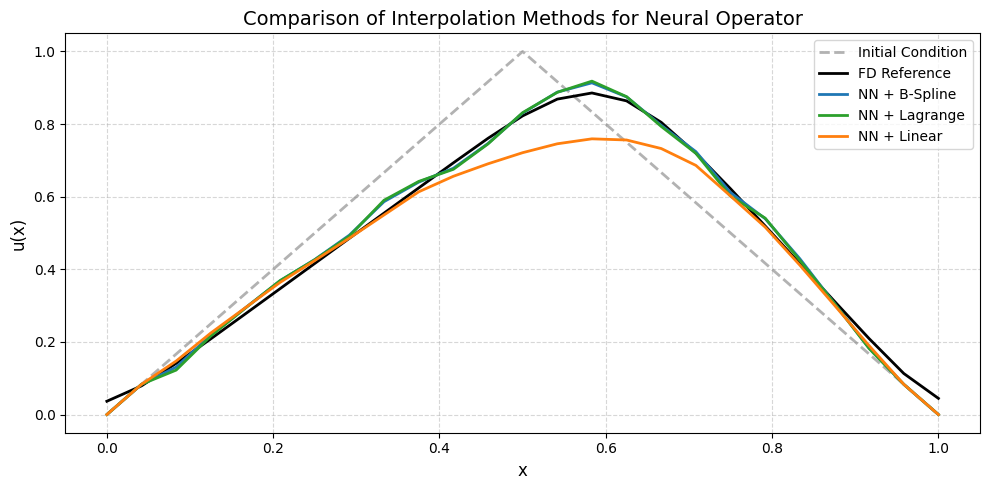

In [ ]:
u0 = get_initial_condition("tent", np.linspace(0, 1, 25))
temp = np.linspace(0, 1, 100)
u_init, u_nn_b, u_fd_b, x = local_interpolation_inference(
    u0,
    model.to(device), mean.to(device), std.to(device),
    t_end = 0.1,
    dt_fine = 0.001,     # the network’s trained dt
    dx_fine = temp[1] - temp[0],      # the network’s trained dx
    interpolation='bspline',   #cubic
    pg=False, alpha=0.01,
    plot=False)

_, u_nn_l, u_fd_l, _ = local_interpolation_inference(
    u0,
    model.to(device), mean.to(device), std.to(device),
    t_end = 0.1,
    dt_fine = 0.001,     # the network’s trained dt
    dx_fine = temp[1] - temp[0],      # the network’s trained dx
    interpolation='lagrange',   #cubic
    pg=False, alpha=0.01,
    plot=False)

_, u_nn_linear, u_fd_linear, _ = local_interpolation_inference(
    u0,
    model.to(device), mean.to(device), std.to(device),
    t_end = 0.1,
    dt_fine = 0.001,     # the network’s trained dt
    dx_fine = temp[1] - temp[0],      # the network’s trained dx
    interpolation='linear',   #cubic
    pg=False, alpha=0.01,
    plot=False)
plt.figure(figsize=(10, 5))

plt.plot(x, u_init, label='Initial Condition', color='gray', linestyle='--', linewidth=2, alpha=0.6)
plt.plot(x, u_fd_b, label='FD Reference', color='black', linewidth=2)
plt.plot(x, u_nn_b, label='NN + B-Spline', color='tab:blue', linewidth=2)
plt.plot(x, u_nn_l, label='NN + Lagrange', color='tab:green', linewidth=2)
plt.plot(x, u_nn_linear, label='NN + Linear', color='tab:orange', linewidth=2)

plt.title("Comparison of Interpolation Methods for Neural Operator", fontsize=14)
plt.xlabel("x", fontsize=12)
plt.ylabel("u(x)", fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend(fontsize=10, loc='best')
plt.tight_layout()
plt.show()

In [ ]:
def visualize_bspline_interpolation(u, i, dx_coarse, r):
    """
    Visualize B-spline interpolation used at coarse node i.
    Shows interpolated smooth curve and evaluation stencil points.
    """
    x_nodes = np.linspace(-2, 2, 5)
    u_nodes = u[i-2:i+3]

    # Build cubic B-spline
    spline = make_interp_spline(x_nodes, u_nodes, k=3)

    # Evaluation grid for smooth plot
    x_dense = np.linspace(-2, 2, 200)
    y_dense = spline(x_dense)

    # Evaluate spline at interpolation stencil points
    x_interp = r * np.array([-2, -1, 0, 1, 2])
    y_interp = spline(x_interp)

    # Plot
    plt.figure(figsize=(8, 4))
    plt.plot(x_dense, y_dense, label='Cubic B-spline (smooth)', color='blue')
    plt.scatter(x_nodes, u_nodes, color='black', label='Coarse Grid Nodes')
    plt.scatter(x_interp, y_interp, color='red', label='Interpolated Points (Stencil)')
    plt.title(f"B-spline Interpolation Around Node {i}")
    plt.xlabel("Local coordinate")
    plt.ylabel("Interpolated value")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

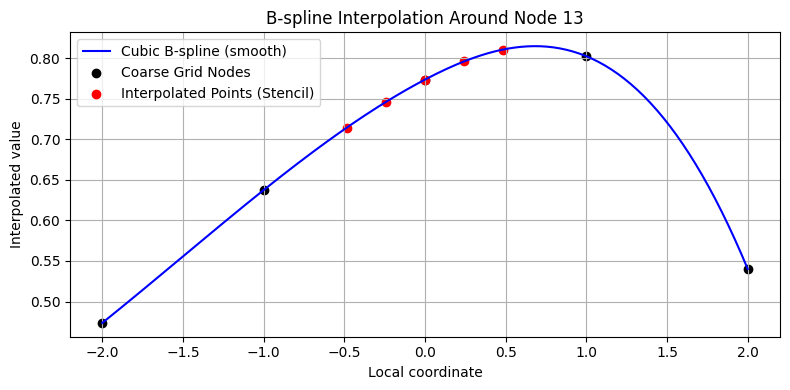

In [ ]:
# Example usage:
# Assume u_coarse is the final or initial solution, r is dx_fine / dx_coarse
temp = np.linspace(0, 1, 25)
dx_coarse = temp[1] - temp[0]
r = dx_fine / dx_coarse
visualize_bspline_interpolation(u_nn, i=13, dx_coarse=dx_coarse, r=r)

# Old code


In [ ]:
|import numpy as np
import torch
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

def run_on_coarse_grid_patchwise(N_coarse=25, t_end=0.1, dt=0.001, nu=0.01,
                                  initial_type='sine', pg=False, plot=True,
                                  base_model=None, mean=None, std=None, alpha=0.01):
    device = torch.device("cpu")
    x_coarse = np.linspace(0, 1, N_coarse)
    dx_coarse = x_coarse[1] - x_coarse[0]
    steps = int(t_end / dt)

    # Set up initial condition
    if initial_type == 'sine':
        u_coarse = np.sin(2 * np.pi * x_coarse)
    elif initial_type == 'step':
        u_coarse = np.where(x_coarse < 0.5, 1.0, 0.0)
    else:
        raise ValueError("Unsupported initial condition type")

    u_init = u_coarse.copy()
    u_ref = u_coarse.copy()

    # Virtual high-res stencil spacing
    dx_model = 0.01
    n_points = 9
    offsets = np.linspace(-2 * dx_model, 2 * dx_model, n_points)

    for step in range(steps):
        u_next = u_coarse.copy()
        interp_fn_curr = interp1d(x_coarse, u_coarse, kind='linear', fill_value='extrapolate')
        interp_fn_next = interp1d(x_coarse, u_next, kind='linear', fill_value='extrapolate')

        for i in range(2, N_coarse - 2):
            x_i = x_coarse[i]
            local_fine_x = x_i + offsets

            # Interpolated stencils
            stencil_curr = interp_fn_curr(local_fine_x)
            stencil_next = interp_fn_next(local_fine_x)
            stencil = np.concatenate([stencil_curr, stencil_next[[1, 2, 6, 7]]])

            # Normalize input
            stencil_tensor = torch.tensor([stencil], dtype=torch.float32, device=device)
            stencil_tensor = (stencil_tensor - mean.to(device)) / std.to(device)

            pred = base_model(stencil_tensor).item()

            if pg:
                # Simple PG dissipation
                dudx = (u_coarse[i] - u_coarse[i - 1]) / dx_coarse
                d2udx2 = (u_coarse[i + 1] - 2 * u_coarse[i] + u_coarse[i - 1]) / dx_coarse**2
                pred_low = u_coarse[i] - dt * u_coarse[i] * dudx + nu * dt * d2udx2
                Ri = pred - pred_low
                grad = (u_coarse[i + 1] - u_coarse[i - 1]) / (2 * dx_coarse)
                k_eff = alpha * abs(Ri) / (1e-5 + abs(grad))
                diss = 0.5 * k_eff * d2udx2
                u_next[i] = pred + dt * diss
            else:
                u_next[i] = pred

        u_next[0:2] = u_next[-2:] = 0  # BCs
        u_coarse = u_next.copy()

    # Simple upwind + diffusion reference
    for _ in range(steps):
        u_new = u_ref.copy()
        for i in range(1, N_coarse - 1):
            dudx = (u_ref[i] - u_ref[i - 1]) / dx_coarse
            d2udx2 = (u_ref[i + 1] - 2 * u_ref[i] + u_ref[i - 1]) / dx_coarse**2
            u_new[i] = u_ref[i] - dt * u_ref[i] * dudx + nu * dt * d2udx2
        u_new[0] = u_new[-1] = 0
        u_ref = u_new.copy()

    if plot:
        x_fine = np.linspace(0, 1, 100)
        u_fine_plot = np.interp(x_fine, x_coarse, u_coarse)
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_init, label='Initial')
        plt.plot(x_coarse, u_ref, label='Reference')
        plt.plot(x_coarse, u_coarse, label='Model (coarse)', linestyle='--')
        plt.plot(x_fine, u_fine_plot, label='Model (interp fine)', linestyle=':')
        plt.title("Patchwise Inference via Local Interpolation")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid()
        plt.tight_layout()
        plt.show()

    return u_coarse, u_ref, u_fine_plot

In [ ]:
run_on_coarse_grid_patchwise()

AttributeError: 'NoneType' object has no attribute 'to'

In [ ]:
def run_on_coarse_grid(N_coarse=25, initial_type='sine', pg=False, plot=True, alpha=0.01):
    """
    Run neural operator inference on a coarse grid using a fixed number of fine time steps.

    Args:
        N_coarse (int): Number of spatial points in the coarse grid.
        initial_type (str): Type of initial condition (e.g. 'sine', 'square_wave', etc.).
        pg (bool): Whether to apply Petrov-Galerkin (PG) dissipation.
        plot (bool): Whether to plot results.
        alpha (float): Scaling factor for PG dissipation term.

    Returns:
        u_current (ndarray): Final model solution on the coarse grid.
        u_ref (ndarray): Reference numerical solution using upwind scheme.
    """
    # === 1. Grid setup ===
    x_coarse = np.linspace(0, 1, N_coarse)
    dx_coarse = x_coarse[1] - x_coarse[0]

    # Assume full model was trained on N=100 grid (global fine resolution)
    scale = int(N / N_coarse)       # how many fine steps per coarse step
    dt_fine = dt                    # model was trained with this dt
    dt_coarse = scale * dt_fine     # physical time advanced per coarse step
    steps = int(t_end / dt_coarse)  # number of coarse steps to reach final time

    print(f"[Grid Info]")
    print(f"N_coarse = {N_coarse}, dx_coarse = {dx_coarse:.5f}")
    print(f"Fine dt = {dt_fine:.5f}, Coarse dt = {dt_coarse:.5f}, Scale = {scale}, Total steps = {steps}")

    # === 2. Interpolation utility ===
    def interpolate_to_coarse(u_fine):
        x_fine = np.linspace(0, 1, len(u_fine))
        return np.interp(x_coarse, x_fine, u_fine)

    # === 3. Setup initial condition ===
    u_init_fine = get_initial_condition(initial_type)  # N=100 fine resolution
    u_init = interpolate_to_coarse(u_init_fine)        # downsampled to coarse
    u_current = u_init.copy()
    u_ref = u_init.copy()

    current_time = 0.0  # track physical simulation time

    # === 4. Inference loop (coarse steps, each using fine time stepping) ===
    for coarse_step in range(steps):
        print(f"\n[Coarse Step {coarse_step+1}/{steps}]")
        print(f"  Physical time before step: {current_time:.5f}")

        for _ in range(scale):  # perform 'scale' fine time steps
            u_current = run_fixed_point_step(
                u_current, base_model, mean, std, dx_coarse, dt_fine,
                pg=pg, alpha=alpha
            )
            current_time += dt_fine

        print(f"  Physical time after step:  {current_time:.5f}")

    # === 5. Reference numerical rollout (same grid, upwind method) ===
    u_ref = rollout_reference_solution(
        u_ref.copy(), dx_coarse, dt_coarse, nu, t_end
    )

    print("\n[Final Results]")
    print(f"Final model physical time:     {current_time:.5f}")
    print(f"Final reference physical time: {t_end:.5f}")
    print(f"Time difference:               {abs(current_time - t_end):.5e}")

    # === 6. Plotting ===
    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_init, label="Initial", color="gray", linestyle="--")
        plt.plot(x_coarse, u_ref, label="Reference (Upwind)", color="black")
        label = "Model + PG" if pg else "Model"
        plt.plot(x_coarse, u_current, label=label, linestyle='-', color="tab:blue")
        plt.title(f"Inference on Coarse Grid (N = {N_coarse})")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return u_current, u_ref

[Grid Info]
N_coarse = 25, dx_coarse = 0.04167
Fine dt = 0.00100, Coarse dt = 0.00400, Scale = 4, Total steps = 25

[Coarse Step 1/25]
  Physical time before step: 0.00000
  Physical time after step:  0.00400

[Coarse Step 2/25]
  Physical time before step: 0.00400
  Physical time after step:  0.00800

[Coarse Step 3/25]
  Physical time before step: 0.00800
  Physical time after step:  0.01200

[Coarse Step 4/25]
  Physical time before step: 0.01200
  Physical time after step:  0.01600

[Coarse Step 5/25]
  Physical time before step: 0.01600
  Physical time after step:  0.02000

[Coarse Step 6/25]
  Physical time before step: 0.02000
  Physical time after step:  0.02400

[Coarse Step 7/25]
  Physical time before step: 0.02400
  Physical time after step:  0.02800

[Coarse Step 8/25]
  Physical time before step: 0.02800
  Physical time after step:  0.03200

[Coarse Step 9/25]
  Physical time before step: 0.03200
  Physical time after step:  0.03600

[Coarse Step 10/25]
  Physical time be

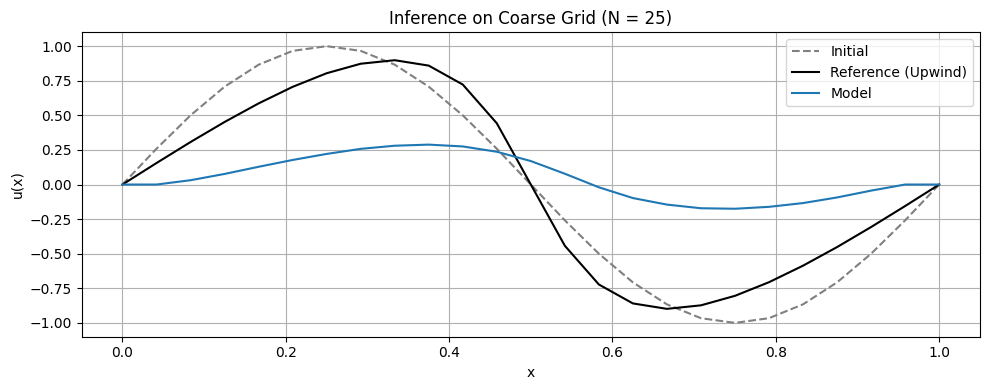

(array([ 0.        ,  0.        ,  0.03114973,  0.07650255,  0.1282424 ,
         0.17743729,  0.22111978,  0.25778842,  0.28031766,  0.28829449,
         0.27515233,  0.23686339,  0.16950154,  0.07793462, -0.02008026,
        -0.09782179, -0.14501558, -0.17135215, -0.17499308, -0.16114827,
        -0.13399819, -0.09332481, -0.04402377,  0.        ,  0.        ]),
 array([ 0.00000000e+00,  1.55406546e-01,  3.07048706e-01,  4.51798006e-01,
         5.86139335e-01,  7.05606827e-01,  8.04097758e-01,  8.72775284e-01,
         8.98186830e-01,  8.59107603e-01,  7.22259429e-01,  4.42560008e-01,
         4.81790340e-16, -4.42560008e-01, -7.22259429e-01, -8.59107603e-01,
        -8.98186830e-01, -8.72775284e-01, -8.04097758e-01, -7.05606827e-01,
        -5.86139335e-01, -4.51798006e-01, -3.07048706e-01, -1.55406546e-01,
         0.00000000e+00]))

In [ ]:
run_on_coarse_grid(N_coarse=25, initial_type='sine', pg=False)

In [ ]:
def run_on_coarse_grid_fixed_dt(N_coarse=25, initial_type='sine', pg=False, plot=True, alpha=0.01):
    # Coarse grid setup
    x_coarse = np.linspace(0, 1, N_coarse)
    dx_coarse = x_coarse[1] - x_coarse[0]

    dt_fixed = dt         # Use the original fine dt
    steps = int(int(t_end / dt_fixed))

    print(f"Fixed dt = {dt_fixed:.6f}, dx_coarse = {dx_coarse:.6f}, steps = {steps}")

    def interpolate_to_coarse(u_fine):
        return np.interp(np.linspace(0, 1, N_coarse), np.linspace(0, 1, len(u_fine)), u_fine)

    # Downsample initial condition
    u_init_fine = get_initial_condition(initial_type)
    u_current = interpolate_to_coarse(u_init_fine)
    u_ref = u_current.copy()
    u_init = u_current.copy()

    # Operator inference with fixed dt
    current_time = 0.0
    for step in range(int(steps/8)):
        print(f"Step {step+1}/{steps} - Physical time: {current_time:.6f}")

        u_next = u_current.copy()
        for _ in range(5):  # fixed-point iteration
            u_new = u_next.copy()
            for i in range(2, N_coarse - 2):
                stencil = [
                    u_current[i-2], u_current[i-1], u_current[i], u_current[i+1], u_current[i+2],
                    u_next[i-2], u_next[i-1], u_next[i+1], u_next[i+2]
                ]
                stencil = torch.tensor([stencil], dtype=torch.float32, device=device)
                stencil = (stencil - mean.to(device)) / std.to(device)
                pred = base_model(stencil).item()

                if pg:
                    dissipation = pg_dissipation(u_next, u_current, i, dx_coarse, alpha=alpha)
                    u_new[i] = pred + dt_fixed * dissipation
                else:
                    u_new[i] = pred
            u_next = u_new.copy()
            u_next[0:2] = u_next[-2:] = 0
        u_current = u_next.copy()
        current_time += dt_fixed

    # Reference solution
    u_ref = u_init.copy()
    ref_time = 0.0
    for _ in range(steps):
        u_ref = upwind_step(u_ref.copy(), dx_coarse, dt_fixed, nu)
        ref_time += dt_fixed

    print(f"\nFinal model time: {current_time:.6f}, Reference time: {ref_time:.6f}")

    # Plotting
    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_init, label="Initial")
        plt.plot(x_coarse, u_ref, label="Reference")
        plt.plot(x_coarse, u_current, label="Model" + (" + PG" if pg else ""), linestyle='--')
        plt.title(f"Inference on Coarse Grid (N={N_coarse}, Fixed dt)")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return u_current, u_ref

Fixed dt = 0.001000, dx_coarse = 0.041667, steps = 100
Step 1/100 - Physical time: 0.000000
Step 2/100 - Physical time: 0.001000
Step 3/100 - Physical time: 0.002000
Step 4/100 - Physical time: 0.003000
Step 5/100 - Physical time: 0.004000
Step 6/100 - Physical time: 0.005000
Step 7/100 - Physical time: 0.006000
Step 8/100 - Physical time: 0.007000
Step 9/100 - Physical time: 0.008000
Step 10/100 - Physical time: 0.009000
Step 11/100 - Physical time: 0.010000
Step 12/100 - Physical time: 0.011000

Final model time: 0.012000, Reference time: 0.100000


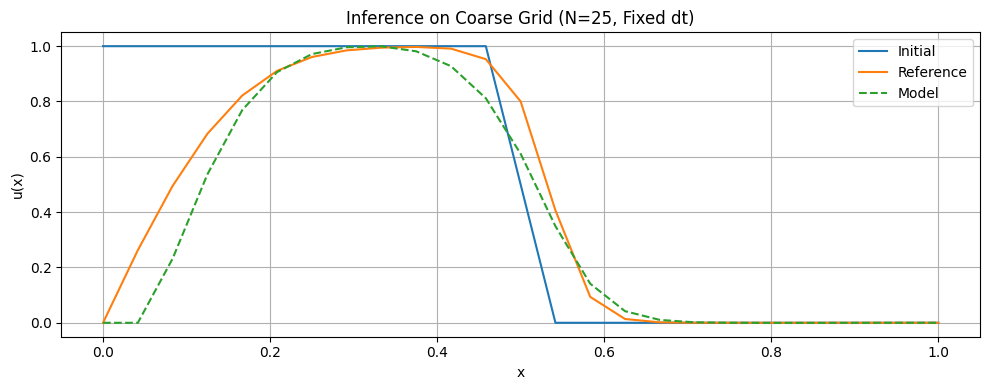

(array([ 0.00000000e+00,  0.00000000e+00,  2.32094347e-01,  5.36950350e-01,
         7.69077897e-01,  9.06169057e-01,  9.71381545e-01,  9.95968342e-01,
         9.99499798e-01,  9.81350482e-01,  9.27661419e-01,  8.11752200e-01,
         6.10969961e-01,  3.49199355e-01,  1.41209453e-01,  4.19193842e-02,
         1.03617078e-02,  1.73160341e-03,  6.81085512e-05, -3.06137837e-04,
        -3.67672183e-04, -3.01805325e-04, -1.61007978e-04,  0.00000000e+00,
         0.00000000e+00]),
 array([0.00000000e+00, 2.62489474e-01, 4.94979670e-01, 6.83548614e-01,
        8.21569319e-01, 9.10774971e-01, 9.60772723e-01, 9.84847299e-01,
        9.94702117e-01, 9.97208417e-01, 9.91088816e-01, 9.53098061e-01,
        8.00280351e-01, 4.06386508e-01, 9.36513467e-02, 1.36676522e-02,
        1.58235975e-03, 1.53784298e-04, 1.28090097e-05, 9.27931588e-07,
        5.91985856e-08, 3.36130180e-09, 1.71407635e-10, 7.89833512e-12,
        0.00000000e+00]))

In [ ]:
run_on_coarse_grid_fixed_dt(N_coarse=25, initial_type='step', pg=False)

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

def run_on_coarse_grid(N_coarse=25, initial_type='sine', pg=False, plot=True, animate=True, alpha=0.01):
    # Coarse grid setup
    x_coarse = np.linspace(0, 1, N_coarse)
    dx_coarse = x_coarse[1] - x_coarse[0]

    scale = int(N / N_coarse)
    dt_fine = dt
    dt_coarse = scale * dt_fine
    steps = int(t_end / dt_coarse)

    print(f"dt_fine = {dt_fine:.6f}, dt_coarse = {dt_coarse:.6f}, dx_coarse = {dx_coarse:.6f}, steps = {steps}, scale = {scale}")

    def interpolate_to_coarse(u_fine):
        return np.interp(np.linspace(0, 1, N_coarse), np.linspace(0, 1, len(u_fine)), u_fine)

    # Initialize fields
    u_init_fine = get_initial_condition(initial_type)
    u_current = interpolate_to_coarse(u_init_fine)
    u_init = u_current.copy()
    u_ref = u_current.copy()
    current_time = 0.0

    history = [u_current.copy()]  # store model predictions

    # Run model
    for coarse_step in range(steps):
        print(f"\n--- Coarse Step {coarse_step+1}/{steps} ---")
        print(f"Starting model physical time: {current_time:.6f}")
        for _ in range(scale):
            u_next = u_current.copy()
            for _ in range(5):
                u_new = u_next.copy()
                for i in range(2, N_coarse - 2):
                    stencil = [
                        u_current[i-2], u_current[i-1], u_current[i], u_current[i+1], u_current[i+2],
                        u_next[i-2], u_next[i-1], u_next[i+1], u_next[i+2]
                    ]
                    stencil = torch.tensor([stencil], dtype=torch.float32, device=device)
                    stencil = (stencil - mean.to(device)) / std.to(device)
                    pred = base_model(stencil).item()

                    if pg:
                        dissipation = pg_dissipation(u_next, u_current, i, dx_coarse, alpha=alpha)
                        u_new[i] = pred + dt_fine * dissipation
                    else:
                        u_new[i] = pred
                u_next = u_new.copy()
                u_next[0:2] = u_next[-2:] = 0
            u_current = u_next.copy()
            current_time += dt_fine
            history.append(u_current.copy())

    # Reference solution
    ref_time = 0.0
    for _ in range(steps):
        u_ref = upwind_step(u_ref.copy(), dx_coarse, dt_coarse, nu)
        ref_time += dt_coarse

    print(f"\nFinal model physical time: {current_time:.6f}")
    print(f"Final reference physical time: {ref_time:.6f}")
    print("Time difference:", abs(current_time - ref_time))

    # Final plot
    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_init, label="Initial")
        plt.plot(x_coarse, u_ref, label="Reference")
        plt.plot(x_coarse, u_current, label="Model" + (" + PG" if pg else ""), linestyle='--')
        plt.title(f"Final State on Coarse Grid (N={N_coarse})")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    # Animation
    if animate:
        fig, ax = plt.subplots(figsize=(10, 4))
        line, = ax.plot([], [], lw=2)
        ax.set_xlim(0, 1)
        ax.set_ylim(np.min(history), np.max(history))
        ax.set_xlabel("x")
        ax.set_ylabel("u(x)")
        ax.set_title("Time Evolution")

        def update(frame):
            line.set_data(x_coarse, history[frame])
            ax.set_title(f"Time = {frame * dt_fine:.4f}")
            return line,

        ani = FuncAnimation(fig, update, frames=len(history), interval=50, blit=True)
        plt.show()

    return u_current, u_ref

In [ ]:
def run_on_coarse_grid_interp_stencil(N_coarse=25, initial_type='sine', pg=False, plot=True, alpha=0.01):
    # Coarse grid setup
    x_coarse = np.linspace(0, 1, N_coarse)
    dx_coarse = x_coarse[1] - x_coarse[0]

    # Fine grid resolution (training resolution of the operator)
    N_fine = 100
    x_fine = np.linspace(0, 1, N_fine)

    scale = int(N_fine / N_coarse)
    dt_fine = dt
    dt_coarse = scale * dt_fine
    steps = int(t_end / dt_coarse)

    print(f"dt_fine = {dt_fine:.6f}, dt_coarse = {dt_coarse:.6f}, dx_coarse = {dx_coarse:.6f}, steps = {steps}, scale = {scale}")

    def interpolate_to_coarse(u_fine):
        return np.interp(np.linspace(0, 1, N_coarse), np.linspace(0, 1, len(u_fine)), u_fine)

    def interpolate_stencil(u_coarse, u_next, i, x_coarse, N_fine=100):
      """
      Interpolates 9-point stencil centered at x_coarse[i] using fine-grid spacing.

      Assumes operator expects 9-point stencil with spacing dx_fine.
      """
      x_center = x_coarse[i]
      dx_fine = 1 / (N_fine - 1)
      # 5 points from u_coarse (current), 4 from u_next (future), total 9
      fine_offsets = np.array([-2, -1, 0, 1, 2]) * dx_fine
      coarse_interp = np.interp(x_center + fine_offsets, x_coarse, u_coarse)
      next_interp = np.interp(np.delete(x_center + fine_offsets, 2), x_coarse, u_next)
      stencil = np.concatenate([coarse_interp, next_interp])
      return stencil

    # Get and downsample initial condition
    u_init_fine = get_initial_condition(initial_type)
    u_current = interpolate_to_coarse(u_init_fine)
    u_ref = u_current.copy()
    u_init = u_current.copy()

    current_time = 0.0

    for coarse_step in range(steps):
        print(f"\n--- Coarse Step {coarse_step+1}/{steps} ---")
        print(f"Starting model physical time: {current_time:.6f}")

        for fine_step in range(scale*scale):
            u_next = u_current.copy()
            for _ in range(5):  # fixed-point iteration
                u_new = u_next.copy()
                for i in range(2, N_coarse - 2):
                    stencil = interpolate_stencil(u_current, u_next, i, x_coarse)
                    stencil_tensor = torch.tensor([stencil], dtype=torch.float32, device=device)
                    stencil_tensor = (stencil_tensor - mean.to(device)) / std.to(device)
                    pred = base_model(stencil_tensor).item()

                    if pg:
                        dissipation = pg_dissipation(u_next, u_current, i, dx_coarse, alpha=alpha)
                        u_new[i] = pred + dt_fine * dissipation
                    else:
                        u_new[i] = pred
                u_next[0:2] = u_next[-2:] = 0
                u_next = u_new.copy()
            u_current = u_next.copy()
            current_time += dt_fine

        print(f"After model rollout, physical time = {current_time:.6f}")

    # Reference solution
    ref_time = 0.0
    for _ in range(steps):
        u_ref = upwind_step(u_ref.copy(), dx_coarse, dt_coarse, nu)
        ref_time += dt_coarse

    print(f"\nFinal model physical time: {current_time:.6f}")
    print(f"Final reference physical time: {ref_time:.6f}")
    print("Time difference:", abs(current_time - ref_time))

    # Plotting
    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_init, label="Initial")
        plt.plot(x_coarse, u_ref, label="Reference")
        plt.plot(x_coarse, u_current, label="Model" + (" + PG" if pg else ""), linestyle='--')
        plt.title(f"Inference on Coarse Grid with Interpolated Stencil (N={N_coarse})")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return u_current, u_ref

dt_fine = 0.001000, dt_coarse = 0.004000, dx_coarse = 0.041667, steps = 25, scale = 4

--- Coarse Step 1/25 ---
Starting model physical time: 0.000000
After model rollout, physical time = 0.016000

--- Coarse Step 2/25 ---
Starting model physical time: 0.016000
After model rollout, physical time = 0.032000

--- Coarse Step 3/25 ---
Starting model physical time: 0.032000
After model rollout, physical time = 0.048000

--- Coarse Step 4/25 ---
Starting model physical time: 0.048000
After model rollout, physical time = 0.064000

--- Coarse Step 5/25 ---
Starting model physical time: 0.064000
After model rollout, physical time = 0.080000

--- Coarse Step 6/25 ---
Starting model physical time: 0.080000
After model rollout, physical time = 0.096000

--- Coarse Step 7/25 ---
Starting model physical time: 0.096000
After model rollout, physical time = 0.112000

--- Coarse Step 8/25 ---
Starting model physical time: 0.112000
After model rollout, physical time = 0.128000

--- Coarse Step 9/25 ---


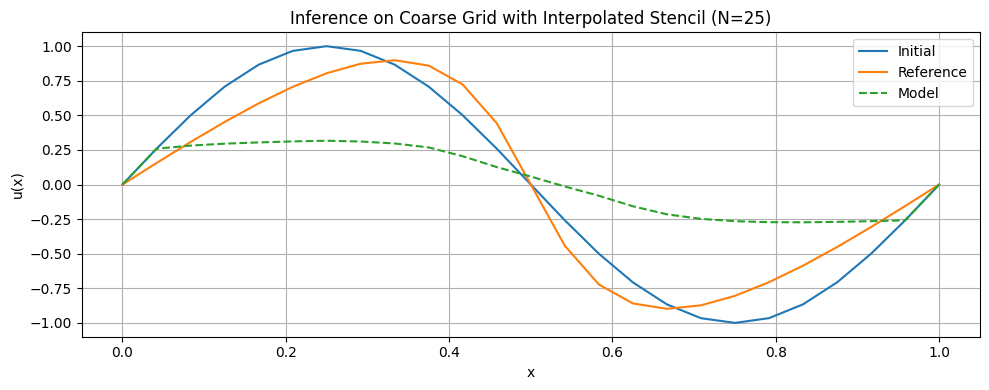

(array([ 0.00000000e+00,  2.58758669e-01,  2.81311870e-01,  2.95168221e-01,
         3.04211497e-01,  3.11510295e-01,  3.16234648e-01,  3.10934544e-01,
         2.96580613e-01,  2.68013388e-01,  2.04306066e-01,  1.26019895e-01,
         5.74678816e-02, -1.40732676e-02, -8.11300427e-02, -1.57147989e-01,
        -2.15414539e-01, -2.48206541e-01, -2.64861047e-01, -2.72051215e-01,
        -2.72987247e-01, -2.69928932e-01, -2.64758408e-01, -2.58758669e-01,
        -2.44929360e-16]),
 array([ 0.00000000e+00,  1.55406546e-01,  3.07048706e-01,  4.51798006e-01,
         5.86139335e-01,  7.05606827e-01,  8.04097758e-01,  8.72775284e-01,
         8.98186830e-01,  8.59107603e-01,  7.22259429e-01,  4.42560008e-01,
         4.81790340e-16, -4.42560008e-01, -7.22259429e-01, -8.59107603e-01,
        -8.98186830e-01, -8.72775284e-01, -8.04097758e-01, -7.05606827e-01,
        -5.86139335e-01, -4.51798006e-01, -3.07048706e-01, -1.55406546e-01,
         0.00000000e+00]))

In [ ]:
run_on_coarse_grid_interp_stencil()

In [ ]:
def run_on_coarse_grid_upsample_then_model(N_coarse=25, initial_type='sine', pg=False, plot=True, alpha=0.01):
    # Grids
    x_coarse = np.linspace(0, 1, N_coarse)
    x_fine = np.linspace(0, 1, 100)  # model expects 100-point resolution
    dx_fine = x_fine[1] - x_fine[0]

    dt_fine = dt  # Use same time step as model was trained on
    steps = int(t_end / dt_fine)

    print(f"Running model with upsampling:")
    print(f"N_coarse = {N_coarse}, N_fine = 100, dt_fine = {dt_fine:.6f}, steps = {steps}")

    def interpolate_to_fine(u_coarse):
        return np.interp(x_fine, x_coarse, u_coarse)

    def interpolate_to_coarse(u_fine):
        return np.interp(x_coarse, x_fine, u_fine)

    # Initial condition (on coarse grid → interpolate up)
    u_init_coarse = get_initial_condition(initial_type, x_coarse)
    u_fine = interpolate_to_fine(u_init_coarse)
    u_fine_init = u_fine.copy()
    u_ref_coarse = u_init_coarse.copy()

    current_time = 0.0

    for step in range(steps):
        u_next = u_fine.copy()
        for _ in range(5):  # fixed-point iteration
            u_new = u_next.copy()
            for i in range(2, 98):
                stencil = [
                    u_fine[i-2], u_fine[i-1], u_fine[i], u_fine[i+1], u_fine[i+2],
                    u_next[i-2], u_next[i-1], u_next[i+1], u_next[i+2]
                ]
                stencil_tensor = torch.tensor([stencil], dtype=torch.float32, device=device)
                stencil_tensor = (stencil_tensor - mean.to(device)) / std.to(device)
                pred = base_model(stencil_tensor).item()

                if pg:
                    diss = pg_dissipation(u_next, u_fine, i, dx_fine, alpha)
                    u_new[i] = pred + dt_fine * diss
                else:
                    u_new[i] = pred
            u_new[0:2] = u_new[-2:] = 0
            u_next = u_new.copy()
        u_fine = u_next.copy()
        current_time += dt_fine

        if step % max(1, steps // 10) == 0:
            print(f"Step {step+1}/{steps}, Time = {current_time:.6f}")

    # Reference solution: numerical on coarse grid
    ref_time = 0.0
    for _ in range(steps):
        u_ref_coarse = upwind_step(u_ref_coarse.copy(), x_coarse[1] - x_coarse[0], dt_fine, nu)
        ref_time += dt_fine

    # Downsample model output to coarse for comparison
    u_model_coarse = interpolate_to_coarse(u_fine)

    # Plotting
    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_init_coarse, label='Initial')
        plt.plot(x_coarse, u_ref_coarse, label='Reference (coarse grid)')
        plt.plot(x_coarse, u_model_coarse, label='Model prediction (interpolated)', linestyle='--')
        plt.plot(x_fine, u_fine, label='Fine', linestyle='dotted')
        plt.title("Model Prediction from Upsampled Grid Inference")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()

    return u_model_coarse, u_ref_coarse, u_fine

Running model with upsampling:
N_coarse = 10, N_fine = 100, dt_fine = 0.001000, steps = 100
Step 1/100, Time = 0.001000
Step 11/100, Time = 0.011000
Step 21/100, Time = 0.021000
Step 31/100, Time = 0.031000
Step 41/100, Time = 0.041000
Step 51/100, Time = 0.051000
Step 61/100, Time = 0.061000
Step 71/100, Time = 0.071000
Step 81/100, Time = 0.081000
Step 91/100, Time = 0.091000


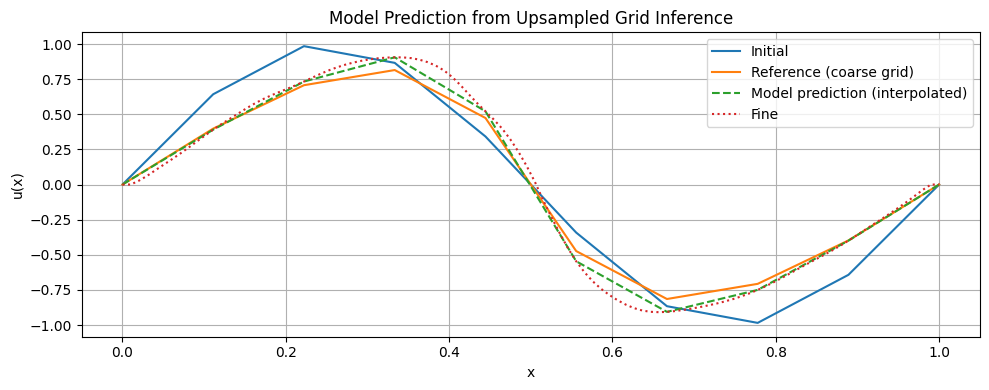

(array([ 0.        ,  0.39079922,  0.73297185,  0.90556037,  0.52124369,
        -0.54633307, -0.90640646, -0.75011432, -0.39936417,  0.        ]),
 array([ 0.        ,  0.39807171,  0.70694871,  0.8148538 ,  0.47365813,
        -0.47365813, -0.8148538 , -0.70694871, -0.39807171,  0.        ]))

In [ ]:
run_on_coarse_grid_upsample_then_model(N_coarse=10)

Running model with upsampling:
N_coarse = 10, N_fine = 100, dt_fine = 0.001000, steps = 100
Step 1/100, Time = 0.001000
Step 11/100, Time = 0.011000
Step 21/100, Time = 0.021000
Step 31/100, Time = 0.031000
Step 41/100, Time = 0.041000
Step 51/100, Time = 0.051000
Step 61/100, Time = 0.061000
Step 71/100, Time = 0.071000
Step 81/100, Time = 0.081000
Step 91/100, Time = 0.091000


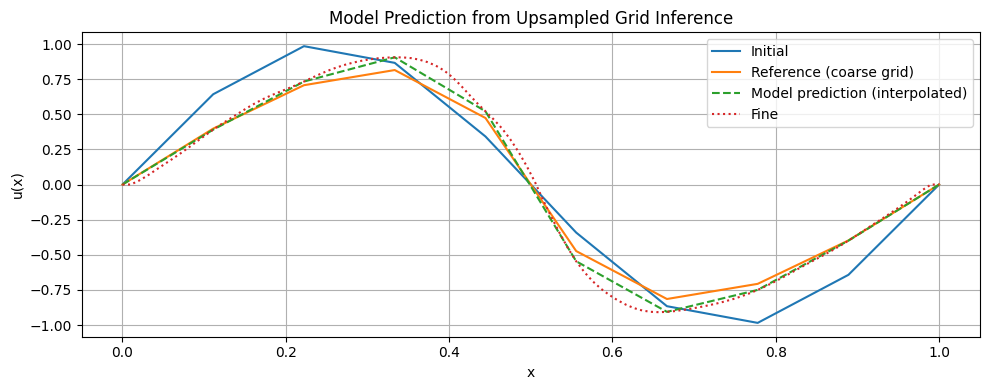

(array([ 0.        ,  0.39080782,  0.73296541,  0.90550717,  0.52125776,
        -0.54633123, -0.90637907, -0.75010568, -0.39937383,  0.        ]),
 array([ 0.        ,  0.39807171,  0.70694871,  0.8148538 ,  0.47365813,
        -0.47365813, -0.8148538 , -0.70694871, -0.39807171,  0.        ]))

In [ ]:
run_on_coarse_grid_upsample_then_model(N_coarse=10, pg=True)

In [ ]:
def run_on_coarse_grid_upsample_then_model(N_coarse=25, initial_type='sine', pg=False, plot=True, alpha=0.01):
    # Grids
    x_coarse = np.linspace(0, 1, N_coarse)
    x_fine = np.linspace(0, 1, 100)  # model expects 100-point resolution
    dx_fine = x_fine[1] - x_fine[0]

    dt_fine = dt  # Use same time step as model was trained on
    steps = int(t_end / dt_fine)

    print(f"Running model with upsampling:")
    print(f"N_coarse = {N_coarse}, N_fine = 100, dt_fine = {dt_fine:.6f}, steps = {steps}")

    def interpolate_to_fine(u_coarse):
        return np.interp(x_fine, x_coarse, u_coarse)

    def interpolate_to_coarse(u_fine):
        return np.interp(x_coarse, x_fine, u_fine)

    # Initial condition (on coarse grid → interpolate up)
    u_init_coarse = get_initial_condition(initial_type, x_coarse)
    u_fine = interpolate_to_fine(u_init_coarse)
    u_fine_init = u_fine.copy()
    u_ref_coarse = u_init_coarse.copy()

    current_time = 0.0

    for step in range(steps):
        u_next = u_fine.copy()
        for _ in range(5):  # fixed-point iteration
            u_new = u_next.copy()
            for i in range(2, 98):
                stencil = [
                    u_fine[i-2], u_fine[i-1], u_fine[i], u_fine[i+1], u_fine[i+2],
                    u_next[i-2], u_next[i-1], u_next[i+1], u_next[i+2]
                ]
                stencil_tensor = torch.tensor([stencil], dtype=torch.float32, device=device)
                stencil_tensor = (stencil_tensor - mean.to(device)) / std.to(device)
                pred = base_model(stencil_tensor).item()

                if pg:
                    diss = pg_dissipation(u_next, u_fine, i, dx_fine, alpha)
                    u_new[i] = pred + dt_fine * diss
                else:
                    u_new[i] = pred
            u_new[0:2] = u_new[-2:] = 0
            u_next = u_new.copy()
        u_fine = u_next.copy()
        current_time += dt_fine

    # Reference solution on coarse grid
    for _ in range(steps):
        u_ref_coarse = upwind_step(u_ref_coarse.copy(), x_coarse[1] - x_coarse[0], dt_fine, nu)

    # High-resolution reference (on fine grid)
    u_ref_fine = get_initial_condition(initial_type, x_fine)
    for _ in range(steps):
        u_ref_fine = upwind_step(u_ref_fine.copy(), x_fine[1] - x_fine[0], dt_fine, nu)

    # Downsample model output to coarse for comparison
    u_model_coarse = interpolate_to_coarse(u_fine)

    if plot:
        # Coarse grid comparison
        plt.figure(figsize=(10, 4))
        plt.plot(x_coarse, u_init_coarse, label='Initial')
        plt.plot(x_coarse, u_ref_coarse, label='Reference (coarse grid)')
        plt.plot(x_coarse, u_model_coarse, label='Model prediction (coarse)', linestyle='--')
        plt.title("Model Prediction on Coarse Grid (via Upsampling)")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()

        # Fine grid comparison
        plt.figure(figsize=(10, 4))
        plt.plot(x_fine, u_fine_init, label="Initial (fine interp)")
        plt.plot(x_fine, u_ref_fine, label="Reference (true fine)")
        plt.plot(x_fine, u_fine, label="Model output (fine)", linestyle='--')
        plt.title(f"Comparison on Fine Grid")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return u_model_coarse, u_ref_coarse, u_fine

Running model with upsampling:
N_coarse = 5, N_fine = 100, dt_fine = 0.001000, steps = 100


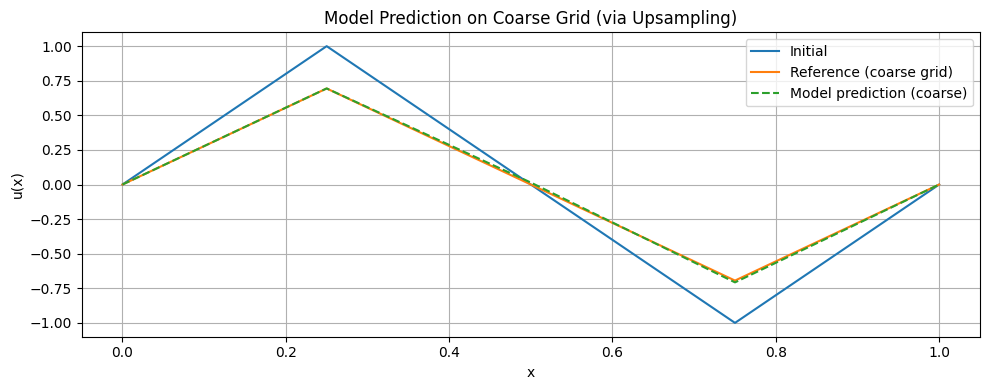

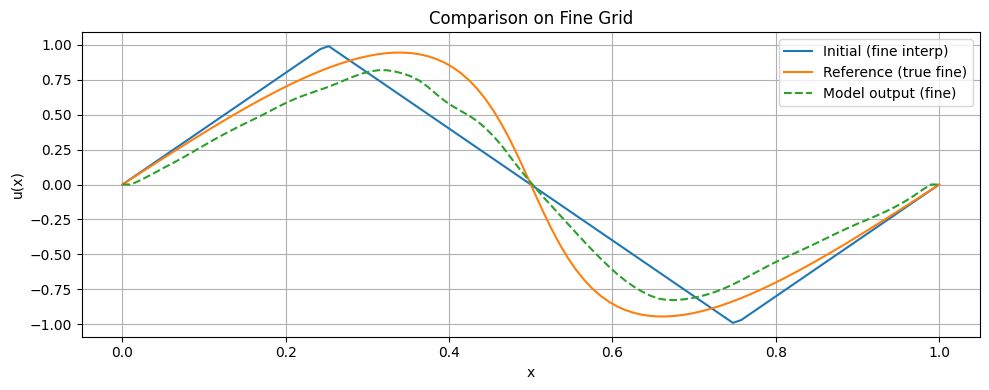

In [ ]:
_, _, u_fine = run_on_coarse_grid_upsample_then_model(N_coarse=5)

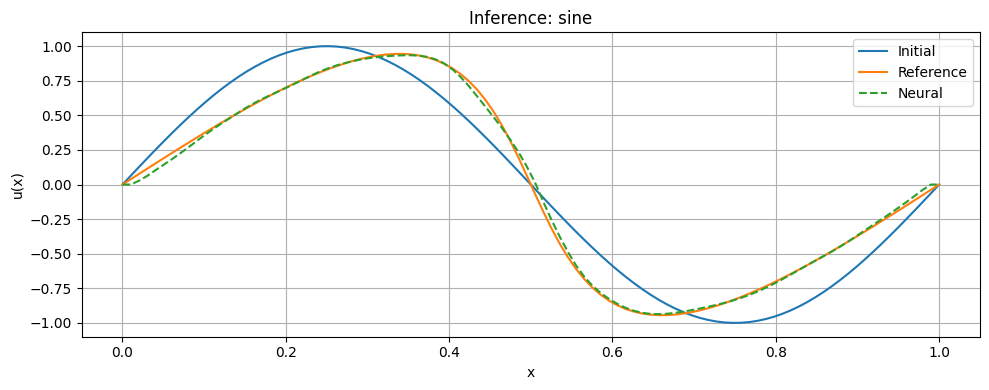

In [ ]:
u_correct, _ = inference('sine', pg=False)

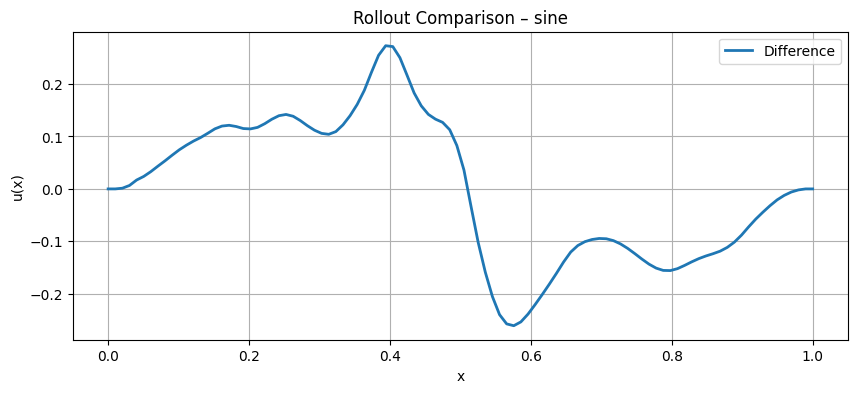

In [ ]:
diff = u_correct - u_fine

plt.figure(figsize=(10, 4))
plt.plot(x, diff, label="Difference", linewidth=2)
plt.title(f"Rollout Comparison – sine")
plt.xlabel("x")
plt.ylabel("u(x)")
plt.legend()
plt.grid(True)

In [ ]:
def rollout_model(initial_type='sine', plot=True, random=False, noise=False, pg=False):
    if noise:
        noise_level = 0.05
        u_current = get_noisy_initial_condition(initial_type, noise_level)
        u_ref = get_noisy_initial_condition(initial_type, noise_level)
        u_init = u_current.copy()
    else:
        if random:
            temp = generate_random_initial()
            u_current = generate_random_initial()
            u_ref = generate_random_initial()
        else:
            u_current = get_initial_condition(initial_type)
            u_ref = get_initial_condition(initial_type)

    t = 0
    history = [u_current.copy()]

    # Fixed-point rollout
    while t < t_end:
        u_next = u_current.copy()
        for _ in range(5):
            u_new = u_next.copy()
            for i in range(2, N - 2):
                stencil = [
                    u_current[i-2], u_current[i-1], u_current[i], u_current[i+1], u_current[i+2],
                    u_next[i-2], u_next[i-1], u_next[i+1], u_next[i+2]
                ]
                stencil = torch.tensor([stencil], dtype=torch.float32).to(device)
                stencil = (stencil - mean) / std
                u_new[i] = base_model(stencil).item()
            u_next = u_new
            u_next[0:2] = u_next[-2:] = 0
        u_current = u_next.copy()
        history.append(u_current.copy())
        t += dt

    # Reference solution
    t = 0
    while t < t_end:
        u_ref = upwind_step(u_ref.copy(), dx, dt, nu)
        t += dt

    # Convert to NumPy for plotting
    u_current = np.array(u_current)

    # Plot results
    if plot and not random:
        plt.figure(figsize=(10, 4))
        plt.plot(x, get_initial_condition(initial_type), label=f"Initial ({initial_type})")
        plt.plot(x, u_ref, label="Reference", linestyle='-')
        plt.plot(x, u_current, label="Model Prediction", linestyle='--')
        plt.title(f"Prediction vs Reference ({initial_type})")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    elif plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x, temp, label=f"Initial ({initial_type})")
        plt.plot(x, u_ref, label="Reference", linestyle='-')
        plt.plot(x, u_current, label="Model Prediction", linestyle='--')
        plt.title(f"Prediction vs Reference ({initial_type})")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return u_current, u_ref

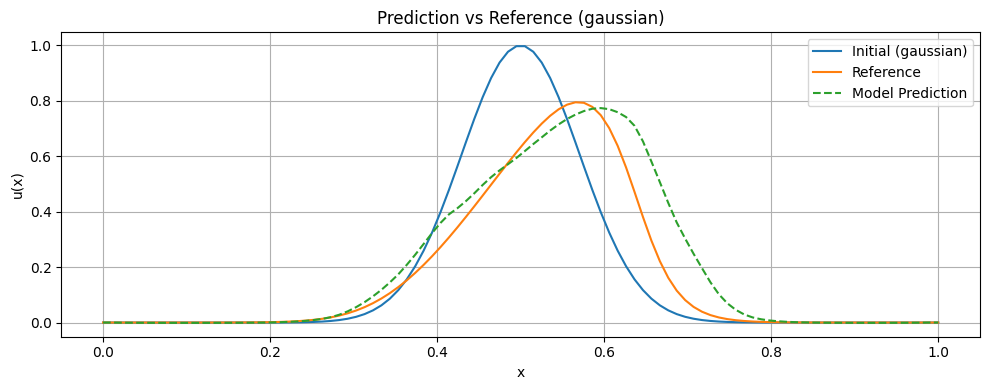

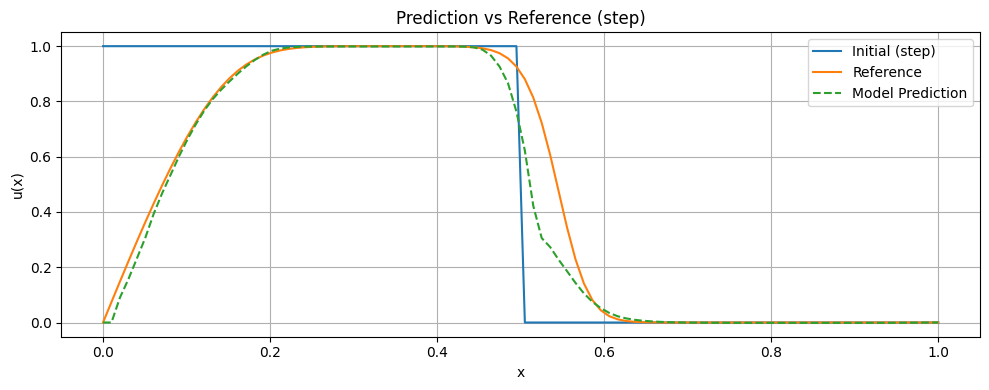

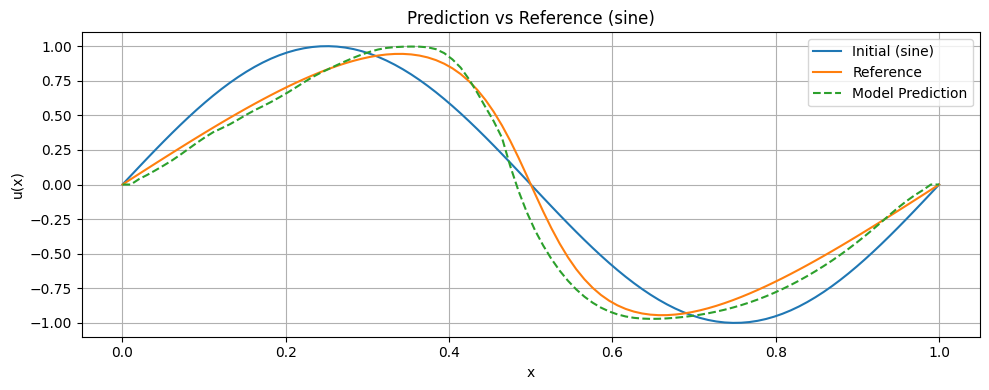

(array([ 0.        ,  0.        ,  0.03906141,  0.06954508,  0.10301259,
         0.13769251,  0.17405345,  0.21469201,  0.25770479,  0.30068937,
         0.34107232,  0.37823951,  0.40616208,  0.43514824,  0.46874183,
         0.50396276,  0.53634936,  0.56579399,  0.59629786,  0.62954468,
         0.66409075,  0.70100904,  0.73874217,  0.77541715,  0.8069855 ,
         0.83511573,  0.8632769 ,  0.8904193 ,  0.91603148,  0.93939489,
         0.95945114,  0.97596604,  0.9870615 ,  0.99302638,  0.99595714,
         0.99704379,  0.99623328,  0.99157512,  0.97811109,  0.94963151,
         0.90408832,  0.8444984 ,  0.76124769,  0.66441202,  0.55942315,
         0.45748127,  0.33845043,  0.13408467, -0.04503763, -0.19817953,
        -0.32991385, -0.44089729, -0.53801662, -0.62258422, -0.69535142,
        -0.75776529, -0.81053001, -0.85425168, -0.88957065, -0.91735095,
        -0.93840188, -0.95349723, -0.96338457, -0.96882099, -0.97084659,
        -0.97016579, -0.96735793, -0.96292406, -0.9

In [ ]:
rollout_model('gaussian', random=False)
rollout_model('step', random=False)
rollout_model('sine', random=False)

Also calculate the final state using the numercial method:

In [ ]:
def pg_rollout_model(initial_type='sine', plot=True, random=False, noise=False):

    if noise:
        noise_level = 0.05
        u_current = get_noisy_initial_condition(initial_type, noise_level)
        u_ref = get_noisy_initial_condition(initial_type, noise_level)
        u_init = u_current.copy()
    else:
        if random:
            np.random.seed(42)
            u_current = np.random.rand(N)
            u_current[0:2] = u_current[-2:] = 0
            u_ref = u_current.copy()
            u_init = u_current.copy()
        else:
            u_current = get_initial_condition(initial_type)
            u_ref = get_initial_condition(initial_type)
            u_init = u_current.copy()

    t = 0
    while t < t_end:
        u_next = u_current.copy()
        for _ in range(5):  # fixed-point iterations
            u_new = u_next.copy()
            for i in range(2, N - 2):
                stencil = [
                    u_current[i-2], u_current[i-1], u_current[i], u_current[i+1], u_current[i+2],
                    u_next[i-2], u_next[i-1], u_next[i+1], u_next[i+2]
                ]
                stencil = torch.tensor([stencil], dtype=torch.float32, device=device)
                stencil = (stencil - mean.to(device)) / std.to(device)
                pred = base_model(stencil).item()

                dissipation = pg_dissipation(u_next, u_current, i, dx, alpha=0.01)

                u_new[i] = pred + dt * dissipation
            u_next = u_new.copy()
            u_next[0:2] = u_next[-2:] = 0

        u_current = u_next.copy()
        t += dt

    # Reference solution
    t = 0
    while t < t_end:
        u_ref = upwind_step(u_ref.copy(), dx, dt, nu)
        t += dt

    # Ensure data is CPU numpy arrays
    u_plot = u_current if isinstance(u_current, np.ndarray) else u_current.detach().cpu().numpy()
    u_init = u_init if isinstance(u_init, np.ndarray) else u_init.detach().cpu().numpy()
    u_ref = u_ref if isinstance(u_ref, np.ndarray) else u_ref.detach().cpu().numpy()

    # Plot
    if plot:
        plt.figure(figsize=(10, 4))
        plt.plot(x, u_init, label="Initial")
        plt.plot(x, u_ref, label="Reference")
        plt.plot(x, u_plot, label="Neural + PG", linestyle='--')
        plt.title(f"Rollout: {initial_type}")
        plt.xlabel("x")
        plt.ylabel("u(x)")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return u_plot, u_ref

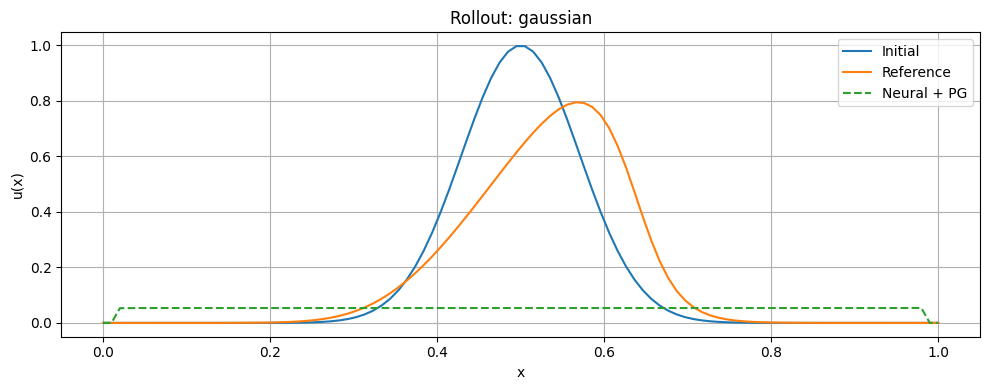

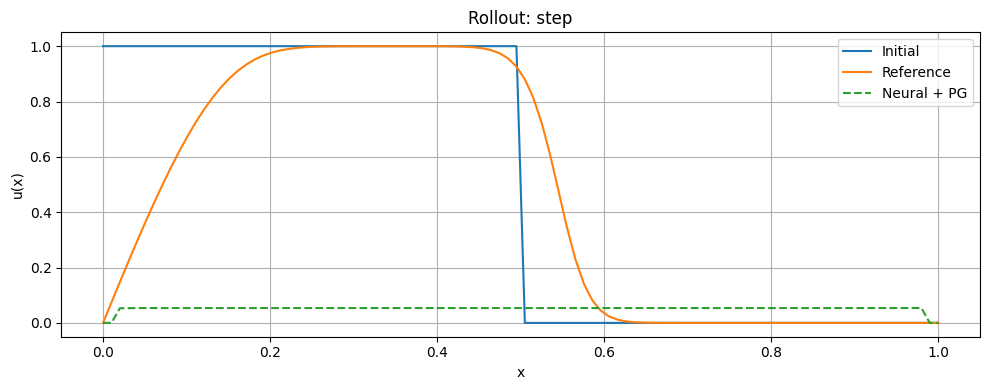

KeyboardInterrupt: 

In [ ]:
# Run tests
pg_rollout_model('gaussian')
pg_rollout_model('step')
pg_rollout_model('sine')

In [ ]:
def difference_rollouts(initial_type='step'):
    u_old, u_init = rollout_model(initial_type, plot=False, random=False)
    u_pg, _ = pg_rollout_model(initial_type, plot=False, random=False)

    #calculate the difference
    u_diff = u_old - u_pg
    # Plot overlay
    plt.figure(figsize=(10, 4))

    plt.plot(x, u_diff, label="Difference", linewidth=2)
    plt.title(f"Rollout Comparison – {initial_type}")
    plt.xlabel("x")
    plt.ylabel("u(x)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


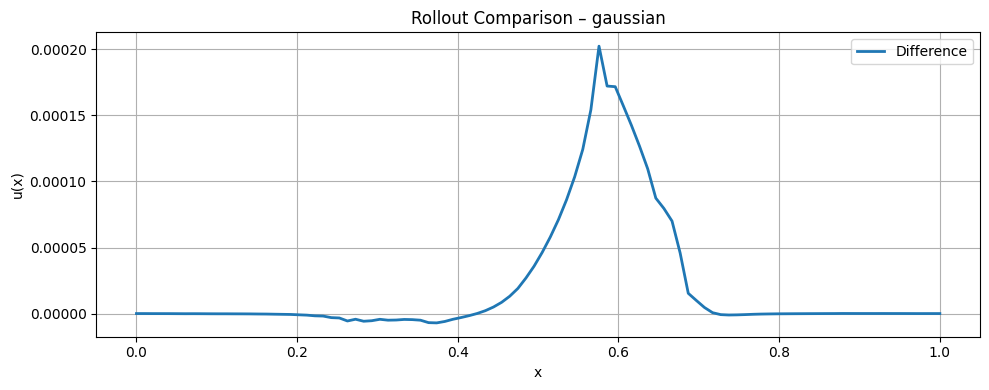

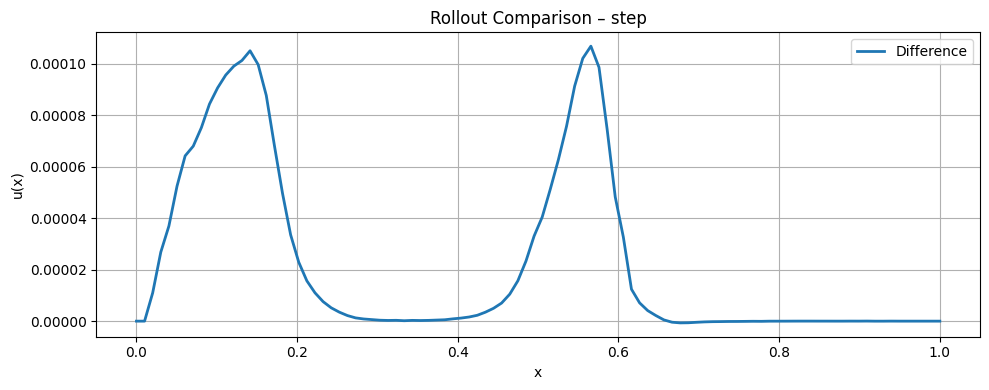

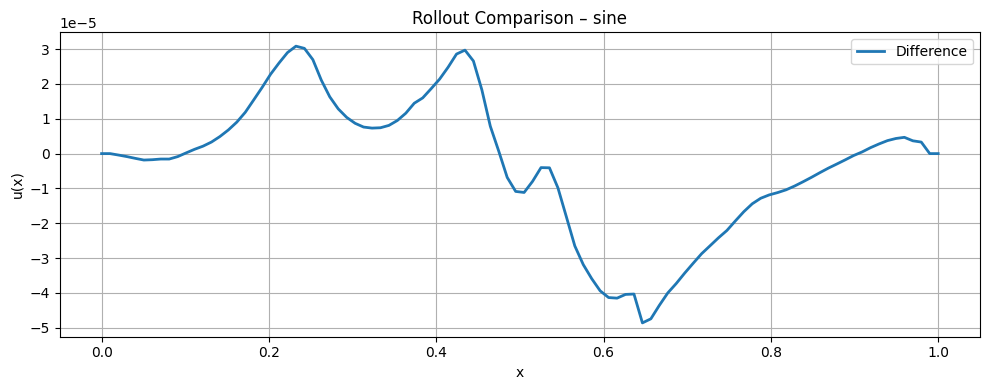

In [ ]:
difference_rollouts('gaussian')
difference_rollouts('step')
difference_rollouts('sine')

In [ ]:
def compare_rollouts(initial_type='step'):
    u_old, u_init = rollout_model(initial_type, plot=False, random=False)
    u_pg, _ = pg_rollout_model(initial_type, plot=False, random=False)

    # Reference solution
    u_ref = get_initial_condition(initial_type)
    t = 0
    while t < t_end:
        u_ref = upwind_step(u_ref.copy(), dx, dt, nu)
        t += dt

    # Plot overlay
    plt.figure(figsize=(10, 4))
    #plt.plot(x, u_init, label="Initial", linestyle='dotted')
    plt.plot(x, u_ref, label="Reference", linewidth=2)
    plt.plot(x, u_old, label="Old Model (No PG)", linestyle='--')
    plt.plot(x, u_pg, label="New Model (With PG)", linestyle='dashdot')
    plt.title(f"Rollout Comparison – {initial_type}")
    plt.xlabel("x")
    plt.ylabel("u(x)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

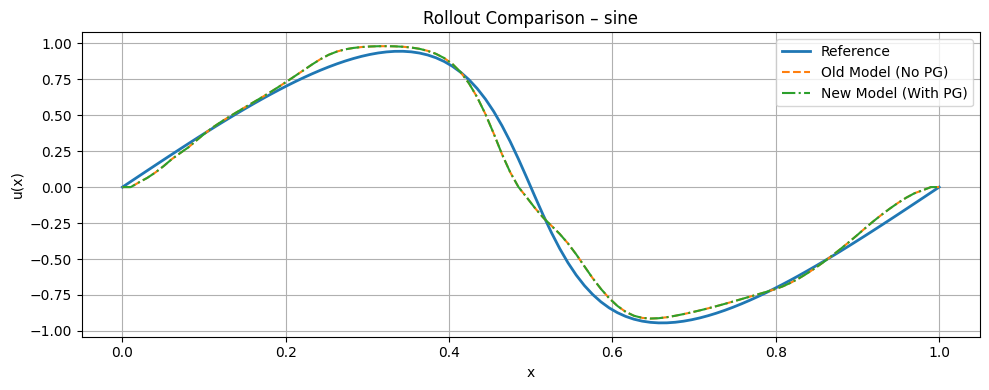

In [ ]:
compare_rollouts('sine')

In [ ]:
def compare_rollout_errors(initial_type='step'):
    u_old, u_init = rollout_model(initial_type, plot=False, random=False)
    u_pg, _ = pg_rollout_model(initial_type, plot=False, random=False)

    # Generate reference solution
    u_ref = get_initial_condition(initial_type)
    t = 0
    while t < t_end:
        u_ref = upwind_step(u_ref.copy(), dx, dt, nu)
        t += dt

    # Compute absolute errors
    error_old = np.abs(u_old - u_ref)
    error_pg = np.abs(u_pg - u_ref)

    # Compute mean absolute error (MAE)
    mae_old = error_old.mean()
    mae_pg = error_pg.mean()

    # Report
    print(f"Average absolute error for '{initial_type}':")
    print(f"  Old model (no PG):     {mae_old:.6f}")
    print(f"  PG-stabilized model:   {mae_pg:.6f}")

    # Plot error curves
    plt.figure(figsize=(10, 4))
    plt.plot(x, error_old, label="Error (Old Model)", linestyle='--')
    plt.plot(x, error_pg, label="Error (PG Model)", linestyle='-')
    plt.title(f"Absolute Error vs Reference – {initial_type}")
    plt.xlabel("x")
    plt.ylabel("Absolute Error")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

Average absolute error for 'step':
  Old model (no PG):     0.036638
  PG-stabilized model:   0.036641


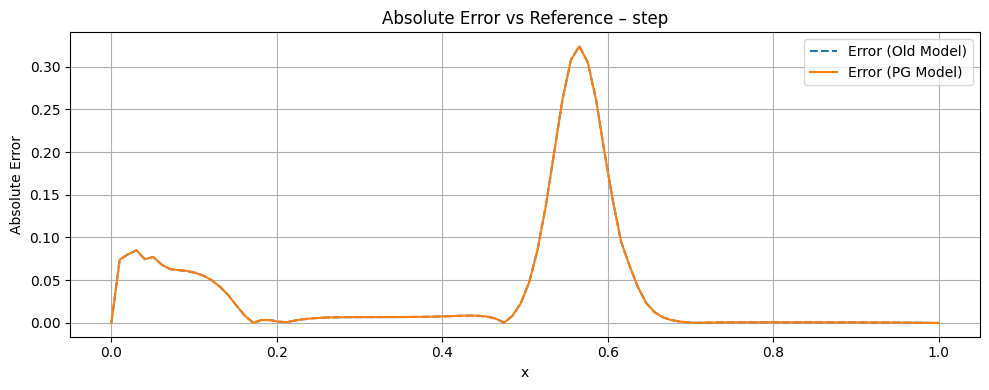

Average absolute error for 'gaussian':
  Old model (no PG):     0.037150
  PG-stabilized model:   0.037171


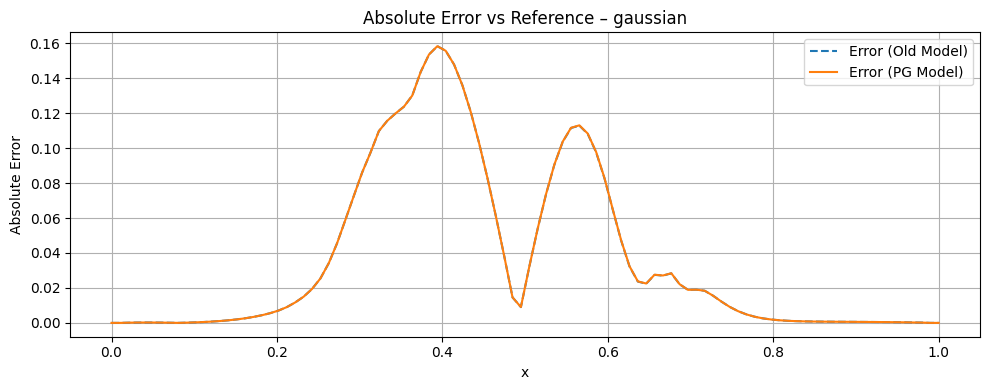

Average absolute error for 'sine':
  Old model (no PG):     0.049198
  PG-stabilized model:   0.049201


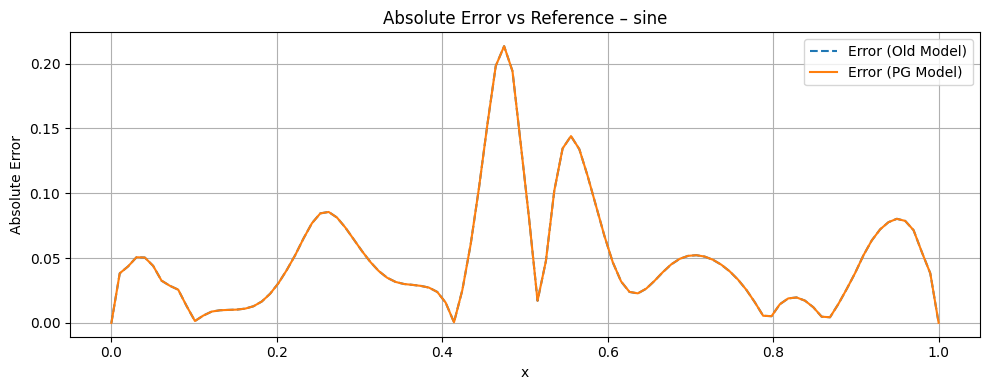

In [ ]:
compare_rollout_errors('step')
compare_rollout_errors('gaussian')
compare_rollout_errors('sine')

In [ ]:
def get_noisy_initial_condition(case='gaussian', noise_level=0.05):
    base = get_initial_condition(case)
    noise = noise_level * np.random.randn(N)
    noisy = base + noise
    noisy[0:2] = noisy[-2:] = 0  # Enforce Dirichlet BC
    return noisy

def compare_with_noisy_initial(initial='gaussian', noise_level=0.05):

    u_ref = get_noisy_initial_condition(initial,noise_level)
    noisy = u_ref.copy()
    out_pg, u_init = pg_rollout_model(initial, noise=True, plot=False)
    out_std, _ = rollout_model(initial, noise=True, plot=False)

    t = 0
    while t < t_end:
        u_ref = upwind_step(u_ref.copy(), dx, dt, nu)
        t += dt

    plt.figure(figsize=(10, 5))
    plt.plot(x, u_ref, label="numerical", linestyle='dotted')
    plt.plot(x, noisy, label="Noisy Initial", linestyle='dashed')
    plt.plot(x, out_std, label="Standard Rollout", linestyle='-')
    plt.plot(x, out_pg, label="PG Rollout", linestyle='-.')
    plt.title(f"Response to Noisy Initial Condition – {initial}")
    plt.xlabel("x")
    plt.ylabel("u(x)")
    plt.legend()
    plt.grid(True)

    plt.show()

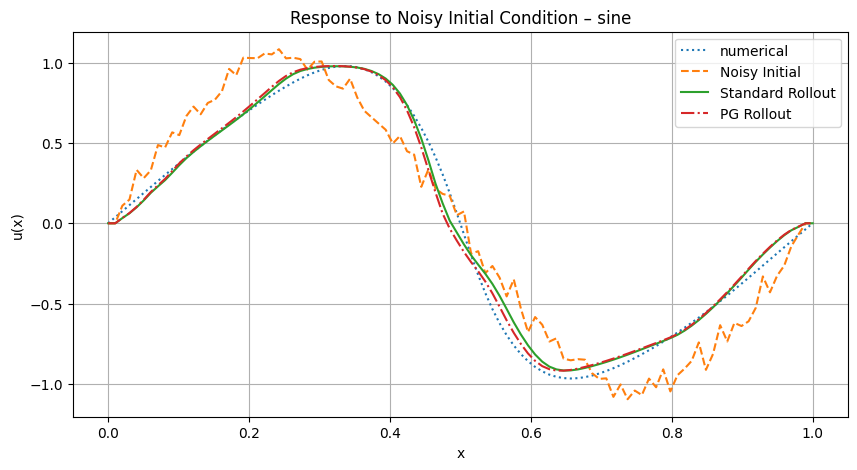

In [ ]:
compare_with_noisy_initial(initial="sine")

In [ ]:
def compare_rollout_errors_noise(initial_type='step'):


    initial = initial_type
    noise_level = 0.05
    u_ref = get_noisy_initial_condition(initial,noise_level)
    noisy = u_ref.copy()
    u_pg, u_init = pg_rollout_model(initial, noise=True, plot=False)
    u_old, _ = rollout_model(initial, noise=True, plot=False)

    t = 0
    while t < t_end:
        u_ref = upwind_step(u_ref.copy(), dx, dt, nu)
        t += dt



    # Compute absolute errors
    error_old = np.abs(u_old - u_ref)
    error_pg = np.abs(u_pg - u_ref)

    # Compute mean absolute error (MAE)
    mae_old = error_old.mean()
    mae_pg = error_pg.mean()

    # Report
    print(f"Average absolute error for '{initial_type}':")
    print(f"  Old model (no PG):     {mae_old:.6f}")
    print(f"  PG-stabilized model:   {mae_pg:.6f}")

    # Plot error curves
    plt.figure(figsize=(10, 4))
    plt.plot(x, error_old, label="Error (Old Model)", linestyle='--')
    plt.plot(x, error_pg, label="Error (PG Model)", linestyle='-')
    plt.title(f"Absolute Error vs Reference – {initial_type}")
    plt.xlabel("x")
    plt.ylabel("Absolute Error")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

Average absolute error for 'sine':
  Old model (no PG):     0.050424
  PG-stabilized model:   0.051178


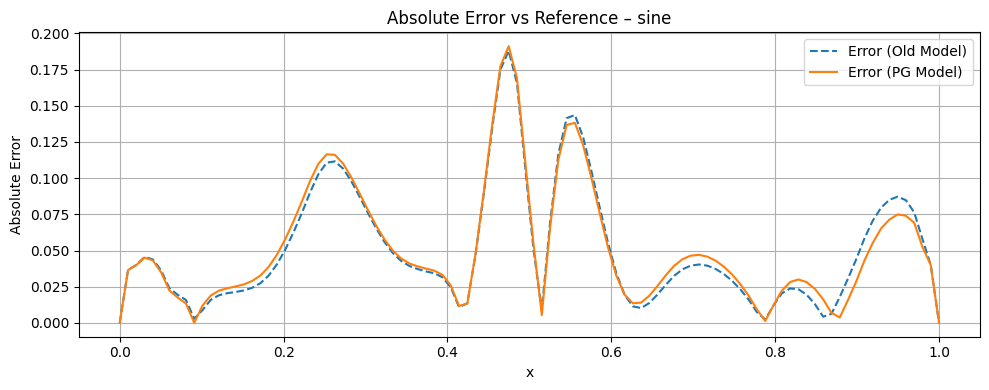

Average absolute error for 'step':
  Old model (no PG):     0.042019
  PG-stabilized model:   0.042154


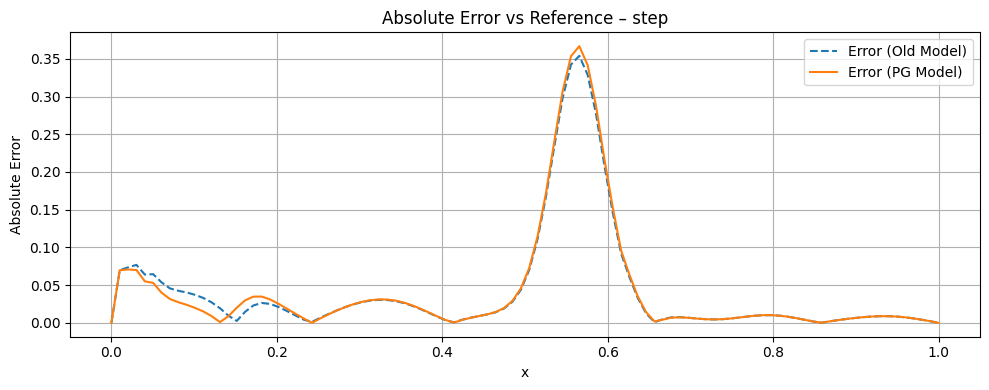

Average absolute error for 'gaussian':
  Old model (no PG):     0.046150
  PG-stabilized model:   0.041852


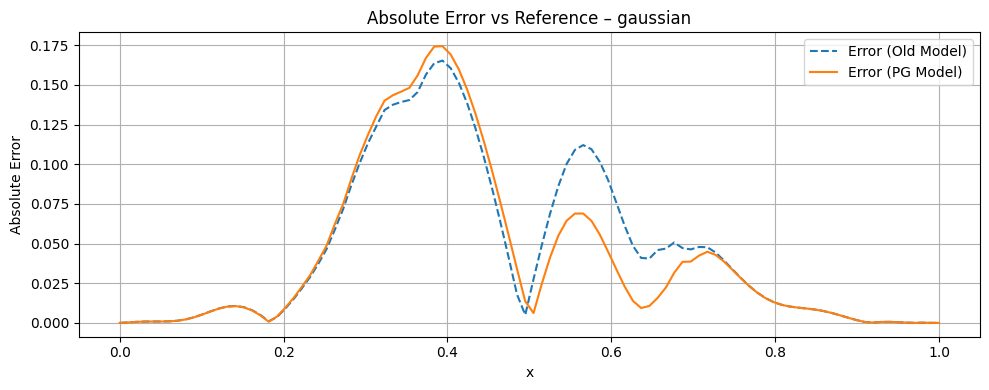

In [ ]:
compare_rollout_errors_noise('sine')
compare_rollout_errors_noise('step')
compare_rollout_errors_noise('gaussian')